In [1]:
from IPython.display import display
from IPython.display import HTML
import IPython.core.display as di # Example: di.display_html('<h3>%s:</h3>' % str, raw=True)

# This line will hide code by default when the notebook is exported as HTML
di.display_html('<script>jQuery(function() {if (jQuery("body.notebook_app").length == 0) { jQuery(".input_area").toggle(); jQuery(".prompt").toggle();}});</script>', raw=True)

# This line will add a button to toggle visibility of code blocks, for use with the HTML export version
di.display_html('''<button onclick="jQuery('.input_area').toggle(); jQuery('.prompt').toggle();">Toggle code</button>''', raw=True)

Toggle code

In [82]:
import os
from pathlib import Path
import pandas as pd
import numpy as np
import boto3
import datetime
import matplotlib.pyplot as plt
from matplotlib.dates import DateFormatter, DayLocator
import seaborn as sns
import fun_eda, fun_s3

In [3]:
####################################  CARGAMOS BASE ORIGINAL
bucket_name = 'movicovid'
fname = '{}/{}/{}'.format('data', 'dataforgood', 'movimientos_entre_administraciones_08062020.csv')
original_data = fun_s3.abre_file_como_df(bucket_name, fname)

####################################   CAMBIO TIPO DE VARIABLES
original_data['starting_region_name'] = original_data['starting_region_name'].astype('category')
original_data['ending_region_name'] = original_data['ending_region_name'].astype('category')
original_data['fecha'] = pd.to_datetime(original_data['fecha'])
original_data['hr'] = original_data['hora'].str.slice(start=0, stop=2).astype(int)

####################################   SELECCIONAMOS VARIABLES DE INTERES
data = original_data[['difference', 'baseline_people_moving', 'crisis_people_moving', 'starting_region_name', 'percent_change',
                     'ending_region_name', 'length_km', 'hr','fecha']].copy()

####################################  DROP REGISTROS DUPLICADOS
# elimina todos, menos el primero
data.drop_duplicates(subset = ['difference', 'baseline_people_moving', 'crisis_people_moving', 'starting_region_name',
                               'percent_change', 'ending_region_name', 'length_km', 'hr','fecha'], 
                              keep = 'first', inplace = True) 

In [132]:
delegaciones = ["Álvaro Obregón", "Azcapotzalco", "Benito Juárez", "Coyoacán", "Cuajimalpa de Morelos", "Cuauhtémoc",
                "Gustavo A. Madero", "Iztacalco", "Iztapalapa", "La Magdalena Contreras", "Miguel Hidalgo", "Milpa Alta",
                "Tláhuac", "Tlalpan", "Venustiano Carranza", "Xochimilco"]

alc_mun = pd.Series(data['starting_region_name'].unique()).append(pd.Series(data['ending_region_name'].unique())).unique()

municipios = alc_mun[~alc_mun.isin(delegaciones)]

In [131]:
alc_mun[~alc_mun.isin(delegaciones)]

[Tultitlán, Ixtapaluca, Chalco, Temamatla, Cuautitlán, ..., Coacalco de Berriozábal, Cocotitlán, Tenango del Aire, Tultepec, Melchor Ocampo]
Length: 50
Categories (66, object): [Azcapotzalco, Benito Juárez, Tultitlán, Tlalpan, ..., Tenango del Aire, Tultepec, Melchor Ocampo, Cuauhtémoc]

In [5]:
####################################   TRANSFORMACION DE VARIABLES  ####################################

#### Añado columnas que indican si el Origen/Destino es en CDMX
data = data.assign(ori_cdmx=np.where(data["starting_region_name"].isin(delegaciones), 'CDMX', 'Otro'), 
                   des_cdmx=np.where(data["ending_region_name"].isin(delegaciones), 'CDMX', 'Otro'))

### Añado una columna que contabilice el numero de semanas
data['num_semana'] = data['fecha'].dt.week

### Añado una columna para el dia de la semana
dict_days = {0:'Lunes',1:'Martes',2:'Miércoles',3:'Jueves',4:'Viernes',5:'Sábado',6:'Domingo'}
data['dia_semana'] = data['fecha'].dt.dayofweek.map(dict_days)

### Anado una columna para identificar la ruta
data['ruta'] = data['starting_region_name'].astype(str) + " - " + data['ending_region_name'].astype(str)


# Movicovid

## Contexto

El 23 de Marzo, se inicio oficialmente, la Jornada Nacional de Sana distancia, que se planteó inicialmente para el período del 23 de Marzo al 19 de Abril. Las medidas de esta campaña incluyeron la suspensión temporal de actividades escolares, la suspensión temporal de actividades no esenciales, la reprogramación de los eventos de concentración masiva, y el **repliegue familiar en casa**, es decir, el mantenerse en casa tratando de respetar la sana distancia de 1.5 metros entre los miembros de la familia.

  - **23 de Marzo 2020**. Inicia Fase 2 y la Jornada Nacional de Sana Distancia [1](http://www.imss.gob.mx/prensa/archivo/202003/142), [2](https://www.dof.gob.mx/nota_detalle.php?codigo=5590339&fecha=24/03/2020), [3](https://www.gob.mx/salud/prensa/095-inicia-fase-2-por-coronavirus-covid-19).
  - **30 de Marzo 2020**. Declaración de Emergencia Sanitaria [4](https://dof.gob.mx/nota_detalle.php?codigo=5590745&fecha=30/03/2020).
  - **21 de Abril 2020**. Inicia Fase 3 por COVID-19 [5](https://www.gob.mx/salud/prensa/110-inicia-la-fase-3-por-covid-19).  Se extiende la Jornada Nacional de Sana Distancia hasta el 30 de mayo de 2020, [6](https://www.dof.gob.mx/nota_detalle.php?codigo=5592067&fecha=21/04/2020).
  - **1 de Junio 2020**. Concluye la Jornada Nacional de Sana Distancia. Inician actividades los sectores neo-esenciales como minería, construcción e industria automotriz, bajo protocolos de seguridad enfocados a evitar contagios en los centros de trabajo [7](http://www.imss.gob.mx/prensa/archivo/202005/356).

Por su parte, y acorde con la política nacional de *#QuédateEnCasa* y *#SanaDistancia*, el Gobierno de la Ciudad de México también suspendió actividades y establecimientos del 23 de Marzo al 19 de Abril, [8](https://www.cdmx.gob.mx/portal/articulo/cierre-temporal-de-actividades-y-establecimientos-por-covid-19). El 31 de Marzo, se dio a conocer que únicamente se mantendrían activos los establecimientos relacionados con servicios de salud, alimentación e indispensables, como gasolineras y bancos, cerrando centros comerciales y otros estableciomientos considerados no escenciales, [9](https://www.cdmx.gob.mx/portal/articulo/cierre-de-centros-comerciales-por-emergencia-sanitaria). El 24 de abril, se cerraron el 20% de las estaciones del Metro, Metrobús y Tren Ligero, y el Hoy No Circula se aplicó para todos los vehículos particulares, con algunas excepciones, [10](https://www.cdmx.gob.mx/portal/articulo/nuevas-medidas-para-la-fase-3-por-covid-9). El 22 de Mayo, se dio a conocer el plan gradual hacia la nueva normalidad, [11](https://www.cdmx.gob.mx/portal/articulo/plan-gradual-hacia-la-nueva-normalidad), [12](https://covid19.cdmx.gob.mx/storage/app/media/plan%20gradual%20hacia%20la%20nueva%20normalidad%20en%20la%20ciudad%20de%20mexico/plangradualhacialanuevanormalidadenlaciudaddemexico20.pdf). El 1 de Julio, se retomaron actividades económicas esenciales, [13](https://www.cdmx.gob.mx/portal/articulo/lineamientos-para-industrias-que-retoman-actividades).


Sin embargo, algunas fuentes periodísticas han afirmado que parte de la población no pudo quedarse en casa durante el período, [14](https://www.elfinanciero.com.mx/nacional/en-mexico-apenas-35-ha-respetado-el-quedate-en-casa-revela-google), [15](https://www.animalpolitico.com/2020/04/municipios-cumplen-quedate-en-casa-covid-19/).

## 1. Total de Rutas

El siguiente análisis considera el **baseline original** de la fuente, por ruta (origen-destino) día de la semana y hora, como base para las comparaciones.

En el análisis previo encontró que de las 23,959 rutas distintas por día, hora y semana, sólo en el 0.14% (35 casos)el baseline es inconsistente, es decir, no es único.

Así, los 239,062 registros de rutas se distribuyen de la siguiente manera:

   - Las rutas con origen y destino fuera de la CDMX representan el 40% de las rutas en la base, mientras que las que tienen origen y destino en la CDMX son el 23.7%.

   - La distribución de las rutas por hora, según su origen destino, se mantiene casi constante a lo largo de las 3 ventanas de tiempo para las rutas con origen y destino fuera de la CDMX.

   - Para las rutas con origen y destino en la CDMX, también se mantuvieron relativamente constantes a lo largo del día.

   - Las rutas con origen fuera de la CDMX y destino en la CDMX concentraron el 22% y 20% a las 8 y 16 horas, pero disminuyeron hasta 14% para las 00 horas. Inversamente, las rutas con origen en la CDMX y destino fuera de la CDMX aumentaron a 23% a las 00 horas, de 13% y 16% a las 8 y 6 horas.

In [6]:
total_rutas = len(data)
rutas = data.groupby(['ori_cdmx', 'des_cdmx']).size()
rutas = rutas.reset_index()  
rutas.columns = ['Origen', 'Destino', 'Rutas']
rutas = rutas.pivot_table(index='Origen', columns='Destino', values='Rutas')
rutas_prop = rutas.divide(total_rutas) * 100

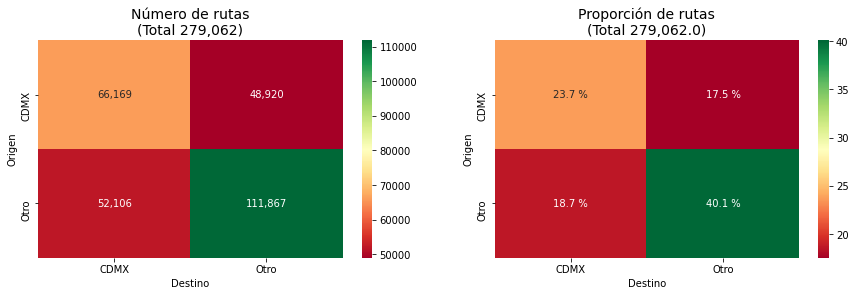

In [7]:
fig, ax = plt.subplots(1, 2, figsize=(15, 4))

sns.heatmap( rutas, annot=True, fmt='0,.0f', cmap='RdYlGn', ax=ax[0])
ax[0].set_title('Número de rutas\n(Total {:0,.0f})'.format(total_rutas), fontsize=14)

sns.heatmap( rutas_prop, annot=True, fmt='0,.1f', cmap='RdYlGn', ax=ax[1])
ax[1].set_title('Proporción de rutas\n(Total {:0,.1f})'.format(total_rutas), fontsize=14)
for t in ax[1].texts: t.set_text(t.get_text() + " %")


plt.show()

In [8]:
ruta_hora = data.groupby(['ori_cdmx', 'des_cdmx', 'hr']).size()
ruta_hora = ruta_hora.reset_index()  
ruta_hora.columns = ['Origen', 'Destino', 'hr', 'Rutas']

ruta0 = ruta_hora[ruta_hora['hr']==0].pivot_table(index='Origen', columns='Destino', values='Rutas')
ruta8 = ruta_hora[ruta_hora['hr']==8].pivot_table(index='Origen', columns='Destino', values='Rutas')
ruta16 = ruta_hora[ruta_hora['hr']==16].pivot_table(index='Origen', columns='Destino', values='Rutas')

ruta0_prop = ruta0.divide(ruta0.values.sum())*100
ruta8_prop = ruta8.divide(ruta8.values.sum())*100
ruta16_prop = ruta16.divide(ruta16.values.sum())*100

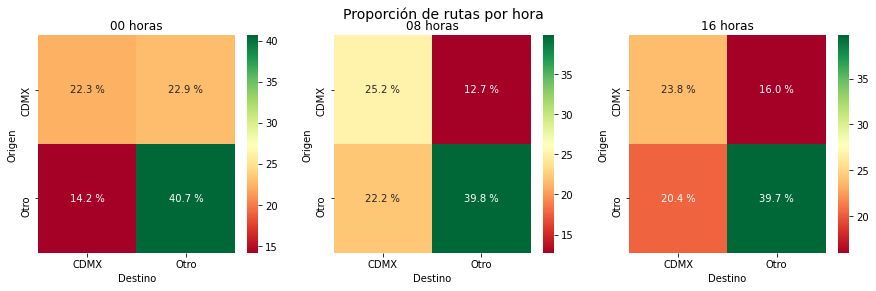

In [9]:
fig, ax = plt.subplots(1, 3, figsize=(15, 4))

sns.heatmap( ruta0_prop, annot=True, fmt='0,.1f', cmap='RdYlGn', ax=ax[0])
ax[0].set_title('00 horas')
for t in ax[0].texts: t.set_text(t.get_text() + " %")

sns.heatmap( ruta8_prop, annot=True, fmt='0,.1f', cmap='RdYlGn', ax=ax[1])
ax[1].set_title('08 horas')
for t in ax[1].texts: t.set_text(t.get_text() + " %")

sns.heatmap( ruta16_prop, annot=True, fmt='0,.1f', cmap='RdYlGn', ax=ax[2])
ax[2].set_title('16 horas')
for t in ax[2].texts: t.set_text(t.get_text() + " %")

fig.suptitle('Proporción de rutas por hora', fontsize=14)
plt.show()
#plt.tight_layout()

### 1.1  Número de personas transitando las rutas

En términos del número de personas que transitan las rutas el 95% se reparte entre rutas con origen y destino en la CDMX y, rutas con origen y destino fuera de la CDMX. El restante 5% de las personas que transitan, lo hace de municipios fuera de la CDMX a las alcaldías de la CDMX o viceversa.

In [10]:
ruta_hora = data.groupby(['ori_cdmx', 'des_cdmx', 'hr']).sum()['crisis_people_moving']
ruta_hora = ruta_hora.reset_index()  
ruta_hora.columns = ['Origen', 'Destino', 'hr', 'Rutas']

ruta0 = ruta_hora[ruta_hora['hr']==0].pivot_table(index='Origen', columns='Destino', values='Rutas')
ruta8 = ruta_hora[ruta_hora['hr']==8].pivot_table(index='Origen', columns='Destino', values='Rutas')
ruta16 = ruta_hora[ruta_hora['hr']==16].pivot_table(index='Origen', columns='Destino', values='Rutas')

ruta0_prop = ruta0.divide(ruta0.values.sum())*100
ruta8_prop = ruta8.divide(ruta8.values.sum())*100
ruta16_prop = ruta16.divide(ruta16.values.sum())*100

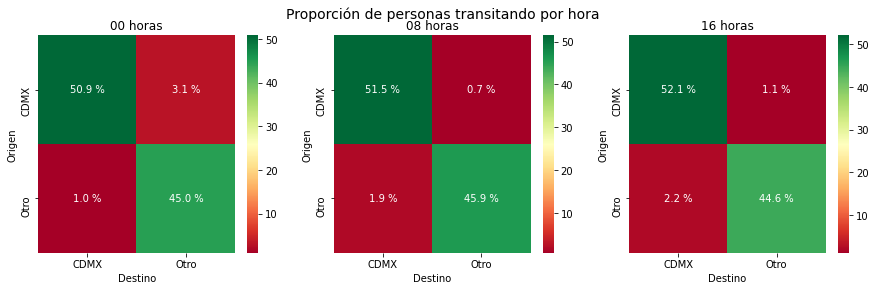

In [11]:
fig, ax = plt.subplots(1, 3, figsize=(15, 4))

sns.heatmap( ruta0_prop, annot=True, fmt='0,.1f', cmap='RdYlGn', ax=ax[0])
ax[0].set_title('00 horas')
for t in ax[0].texts: t.set_text(t.get_text() + " %")

sns.heatmap( ruta8_prop, annot=True, fmt='0,.1f', cmap='RdYlGn', ax=ax[1])
ax[1].set_title('08 horas')
for t in ax[1].texts: t.set_text(t.get_text() + " %")

sns.heatmap( ruta16_prop, annot=True, fmt='0,.1f', cmap='RdYlGn', ax=ax[2])
ax[2].set_title('16 horas')
for t in ax[2].texts: t.set_text(t.get_text() + " %")

fig.suptitle('Proporción de personas transitando por hora', fontsize=14)
plt.show()

Separaremos el análisis para considerar dos conjuntos de datos:

   1. Inter-rutas: Rutas cuyo origen y destino pertenece a municipios o alcaldías diferentes 
   2. Intra-rutas: Rutas con origen y destino en el mismo municipio o alcandía

También haremos el análisis de las rutas separandolas según la ventana de tiempo en que se recorrieron:

   - 08 horas: de las 01:00 a las 8:00 horas
   - 16 horas: de las 09:00 a las 16:00 horas
   - 00 horas: de las 07:00 a las 24:00 horas
 
El número de rutas en cada caso son las siguientes:

| Tipo  | 08 horas | 16 horas | 00 horas | Total |
|:-----:|:--------:|:--------:|:--------:|:-----:|
|Inter-rutas|  1,140   |  1,250   |   1,372  | 3,762 |
|Intra-rutas|     66   |     66   |      66  |   198 |
|Total  |  1,206   |   1,316  |    1,438 | 3,960 |


In [12]:
# Definimos los conjuntos de datos 
# Rutas entre alcaldias/municipios
inter_rutas = data[data['starting_region_name']!=data['ending_region_name']]

# Rutas en el mismo municipio/alcaldia
intra_rutas = data[data['starting_region_name']==data['ending_region_name']]

In [13]:
# Number of unique rutes in each set of data
print("Inter: ", inter_rutas['ruta'].unique().shape[0])
print("Intra: ", intra_rutas['ruta'].unique().shape[0])

Inter:  1505
Intra:  66


In [14]:
#numero de rutas por horario
hora = 8
len(inter_rutas.groupby(['hr', 'ruta']).size().loc[(hora,)])

len(intra_rutas.groupby(['hr','ruta']).size().loc[(hora,)])

66

In [15]:
 # Grafica para determinar los límites de los grupos
def grafica_define_grupos(x_info, y_info, flag):
    
    fig, ax = plt.subplots(figsize=(20,5))
    
    ax = sns.scatterplot(x=x_info, y=y_info)
    plt.axhline(y=0, color='red', linestyle='dashed')
        
    # Encontramos los cuartiles
    grupos = pd.cut(y_info, 4)
    #graficamos una linea en el extremo derecho del cuartil
    for i in range(0,4):
        num = grupos.cat.categories[i].right
        plt.axhline(y=num, color='blue', linestyle='dashed')
    
    if flag==0:
        plt.title('Promedio de cambio de las rutas a lo largo del periodo', fontsize='16')
    else:
        plt.title('Porcentaje de NaN a lo largo del periodo', fontsize='16')
    plt.xticks(fontsize='5', rotation='vertical')
    plt.show()

In [16]:
# Funcion para determinar las rutas que pertenecen a los grupos
# los grupos se calculan con base al promedio 
def asignar_rutas_en_grupos(df_rutas, y_info):
    
    # Encontramos los cuartiles
    grupos = pd.cut(y_info, 4)
    
    #Encontramos las rutas que pertenecen a cafa grupo
    index_grupo1 =  grupos[grupos == grupos.cat.categories[0]].index
    grupo1 = df_rutas.loc[index_grupo1]

    index_grupo2 =  grupos[grupos == grupos.cat.categories[1]].index
    grupo2 = df_rutas.loc[index_grupo2]

    index_grupo3 =  grupos[grupos == grupos.cat.categories[2]].index
    grupo3 = df_rutas.loc[index_grupo3]

    index_grupo4 =  grupos[grupos == grupos.cat.categories[3]].index
    grupo4 = df_rutas.loc[index_grupo4]
    
    return grupo1, grupo2, grupo3, grupo4, grupos.cat.categories

In [17]:
# Graficas por grupos
# Cambio porcentual diario por ruta, todo el periodo

#rutas = grupo1.index
#dias = grupo1.columns

def grafica_cambio_en_en_tiempo_grupos(df_grupo, rutas, dias, group_name, flag):
    #df_grupo: df que contiene las rutas
    #rutas: array con los nombres de las rutas
    #dias: array con los dias del periodo
    #group_name: str con el nombre del grupo
    #flag: para cambiar el titulo
    sns.set_style("darkgrid")
    fig, ax = plt.subplots(figsize=(20,10))
    
    for ruta in rutas:
        ax.plot(df_grupo.loc[ruta])
    plt.axhline(y=0, color='red', linestyle='solid')
    
    myFmt = DateFormatter("%d-%b-%Y")
    ax.xaxis.set_major_formatter(myFmt)
    ax.xaxis.set_major_locator(DayLocator(interval=5))
    ax.xaxis.set_minor_locator(DayLocator())
    
    if flag == 0:
        plt.title('Porcentaje de cambio de las Top 100 rutas mas transitadas\n{}'.format(group_name), fontsize='16')
    else:
        plt.title('Porcentaje de cambio de las rutas con NaN > 50%\n{}'.format(group_name), fontsize='16')
        
    plt.ylabel('Porcentaje de cambio con respecto al baseline', fontsize='16')
    
    plt.axvline(x=datetime.datetime(2020, 3, 23), color='red')
    plt.axvline(x=datetime.datetime(2020, 3, 13), color='red', linestyle='dashed')
    
    plt.xticks(fontsize='14', rotation='vertical')
    plt.yticks(fontsize='14')
    plt.show()

## 2. Inter-rutas

Analizamos las 100 rutas más transitadas y las 100 rutas con mayor número de NaN.

### 2.1 Ventana de tiempo: 08 horas + Top 100 rutas más transitadas


In [99]:
# Rutas registradas en la ventana de las 8 horas
inter_rutas_8hr = inter_rutas.loc[inter_rutas['hr']==8]
inter_rutas_8hr_panel = inter_rutas_8hr.groupby(['ruta', 'fecha']).mean()['percent_change'].unstack()

In [100]:
# Las 100 rutas mas transitadas 
top100_inter_8hr = inter_rutas_8hr.groupby(['ruta']).sum().sort_values(['crisis_people_moving'],ascending=False)[:100][['crisis_people_moving']]

# Porcentaje de personas que cubren las rutas top 100
(top100_inter_8hr['crisis_people_moving'].sum()/inter_rutas_8hr[['crisis_people_moving']].sum()[0])*100

# Prety print
#top100_inter_8hr.round(0).style.format('{:,}')

54.69904909719907

In [101]:
# Porcentaje de cambio en el periodo de las 100 rutas mas transitadas
top100_inter_8hr_panel = inter_rutas_8hr_panel[inter_rutas_8hr_panel.index.isin(top100_inter_8hr.index)]
avg_top100_inter_8hr = top100_inter_8hr_panel.mean(axis=1, skipna=True).sort_values(ascending=False)
#avg_top100_inter_8hr['Ecatepec de Morelos - Gustavo A. Madero']

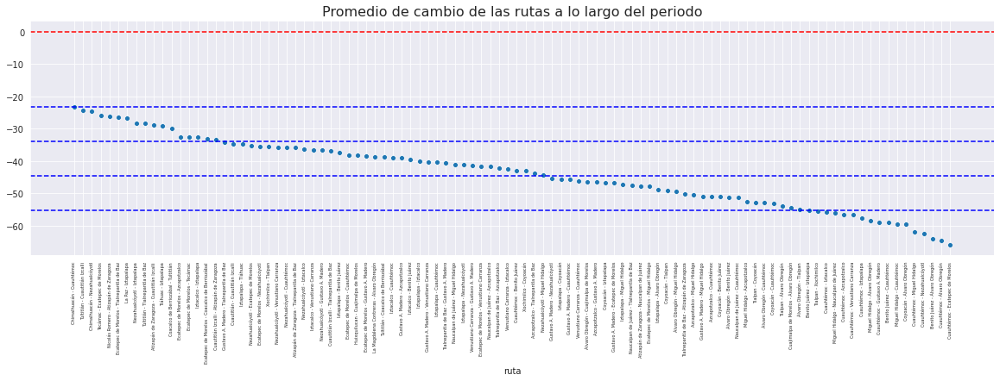

In [102]:
# Determinacion de los intervalos para los grupos
# Usamos quartiles
grafica_define_grupos(avg_top100_inter_8hr.index, avg_top100_inter_8hr, 0)

In [22]:
grupo1, grupo2, grupo3, grupo4, group_cat = asignar_rutas_en_grupos(top100_inter_8hr_panel, avg_top100_inter_8hr)

In [23]:
print('Grupo 1: ', group_cat[0], '\tN: ', grupo1.shape[0])
print('Grupo 2: ', group_cat[1], '\tN: ', grupo2.shape[0])
print('Grupo 3: ', group_cat[2], '\tN: ', grupo3.shape[0])
print('Grupo 4: ', group_cat[3], '\tN: ', grupo4.shape[0])

Grupo 1:  (-65.926, -55.237] 	N:  17
Grupo 2:  (-55.237, -44.59] 	N:  29
Grupo 3:  (-44.59, -33.944] 	N:  37
Grupo 4:  (-33.944, -23.298] 	N:  17


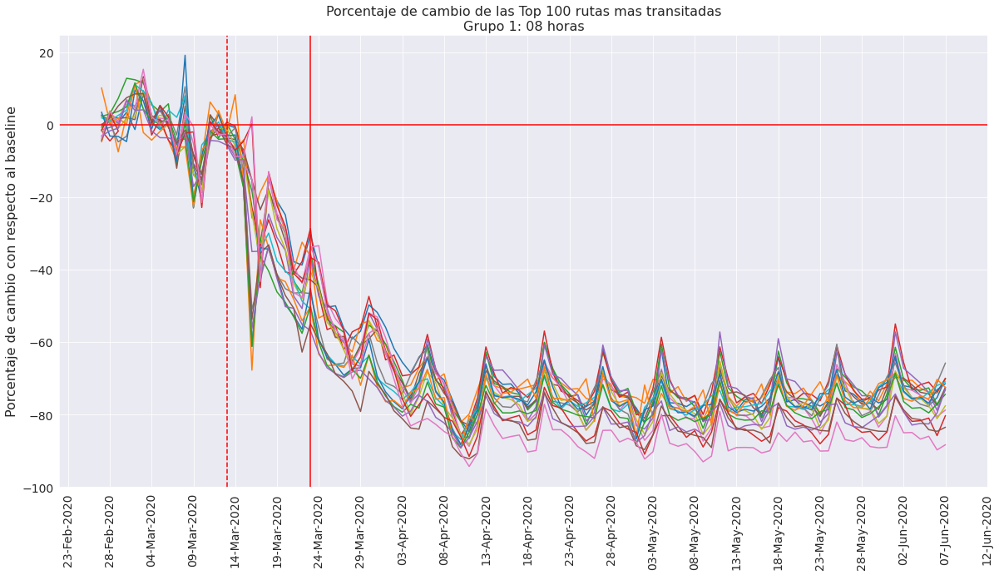

In [24]:
rutas = grupo1.index
dias = grupo1.columns
grafica_cambio_en_en_tiempo_grupos(grupo1, rutas, dias, "Grupo 1: 08 horas", 0)

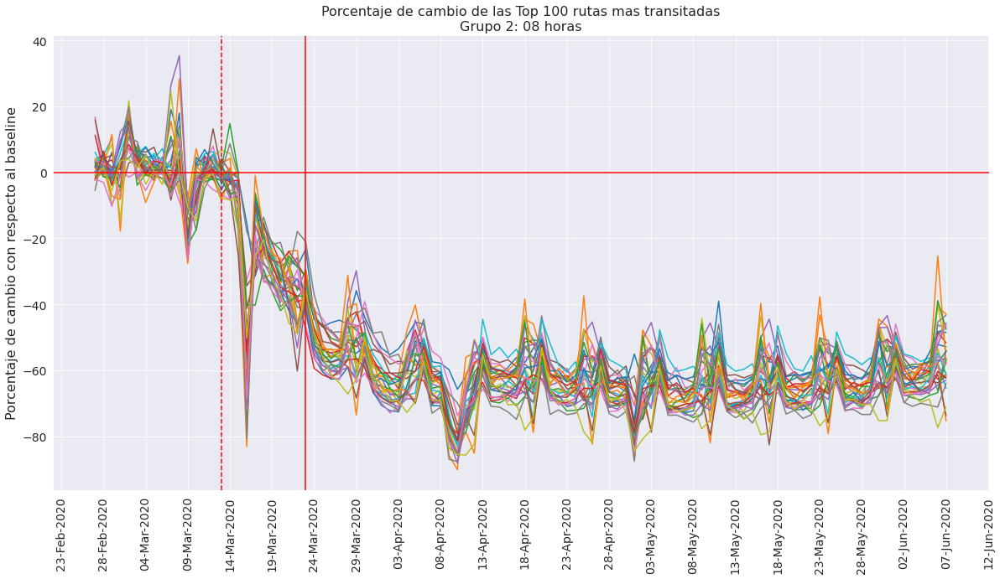

In [25]:
rutas = grupo2.index
dias = grupo2.columns
grafica_cambio_en_en_tiempo_grupos(grupo2, rutas, dias, "Grupo 2: 08 horas", 0)

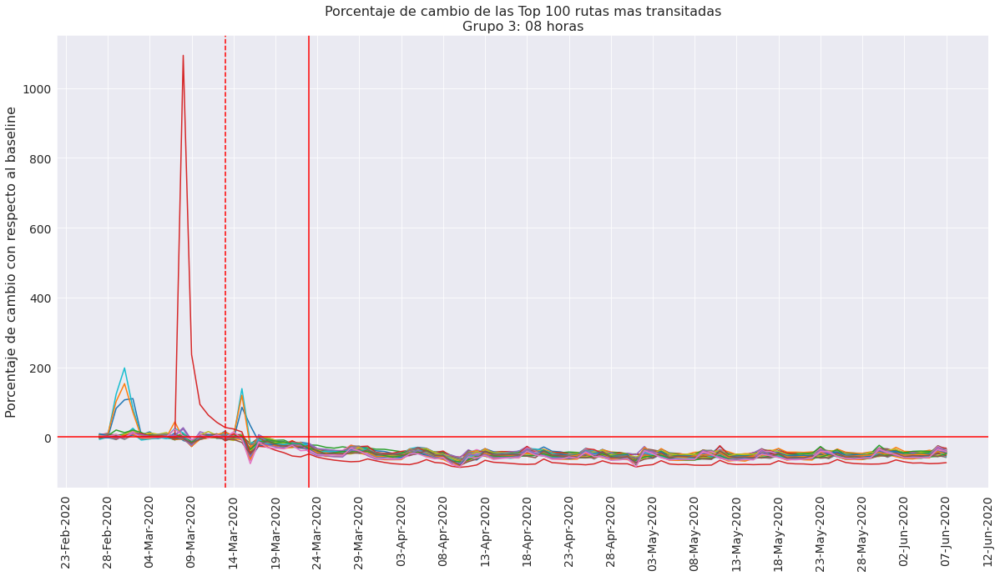

In [26]:
rutas = grupo3.index
dias = grupo3.columns
grafica_cambio_en_en_tiempo_grupos(grupo3, rutas, dias, "Grupo 3: 08 horas", 0)

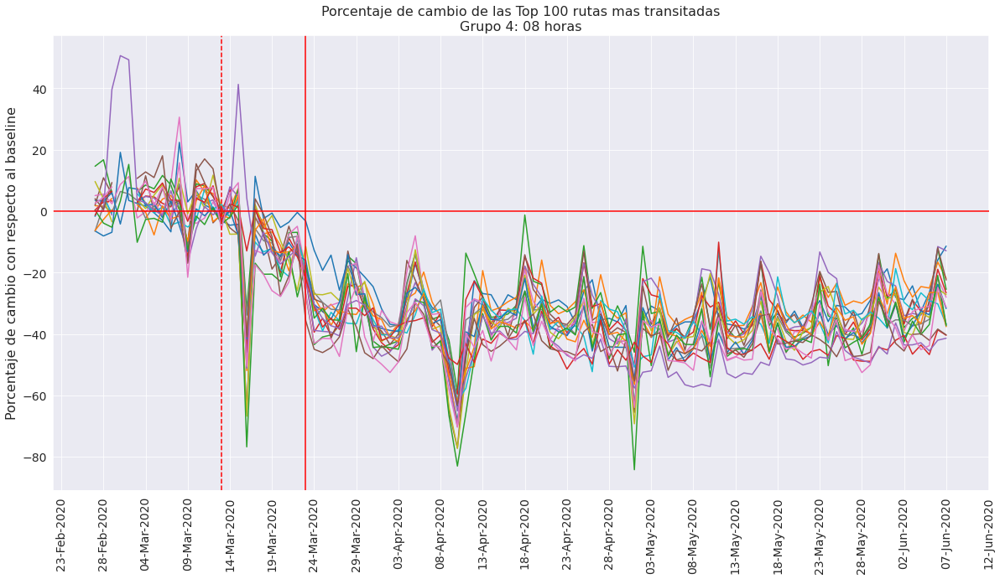

In [27]:
rutas = grupo4.index
dias = grupo4.columns
grafica_cambio_en_en_tiempo_grupos(grupo4, rutas, dias, "Grupo 4: 08 horas", 0)

### 2.2 Ventana de tiempo: 08 horas + Rutas que desaparecieron

Definimos las rutas que desaparecieron como aquellas rutas cuyo porcentaje de NaN es mayor al 50% en todo el periodo considerado.


In [28]:
# Porcentaje de NaN por ruta
inter_rutas_nan = inter_rutas_8hr_panel.isnull().mean(axis=1).sort_values(ascending=False)*100
#inter_rutas_nan

In [29]:
# Rutas con % de missing values mayores al 50%
inter_rutas_desaparecidas_index = inter_rutas_nan[inter_rutas_nan.values>50].index
inter_rutas_desaparecidas = inter_rutas_8hr_panel.loc[inter_rutas_desaparecidas_index]

print("Rutas con % de nan > 50: ", inter_rutas_desaparecidas.shape[0])

Rutas con % de nan > 50:  386


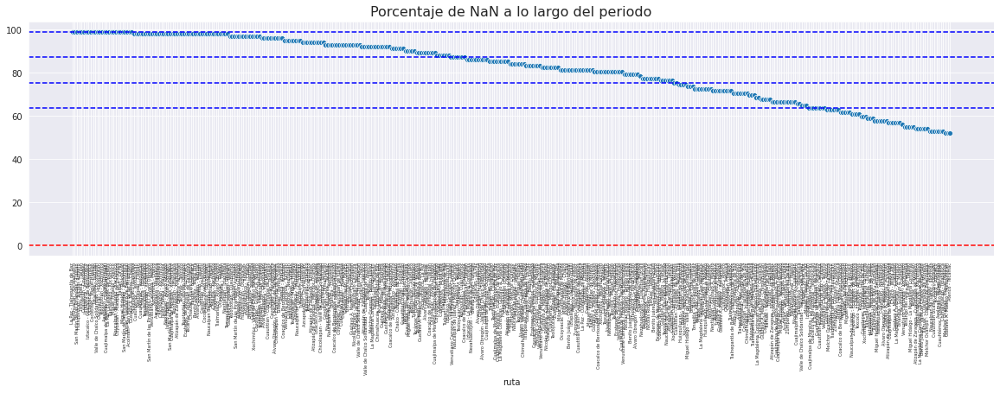

In [30]:
# Determinacion de los intervalos para los grupos
# Usamos quartiles
grafica_define_grupos(inter_rutas_desaparecidas_index, inter_rutas_nan.loc[inter_rutas_desaparecidas_index], 1)

In [31]:
grupo1, grupo2, grupo3, grupo4, group_cat = asignar_rutas_en_grupos(inter_rutas_desaparecidas, inter_rutas_nan.loc[inter_rutas_desaparecidas_index])

In [32]:
print('Grupo 1: ', group_cat[0], '\tN: ', grupo1.shape[0])
print('Grupo 2: ', group_cat[1], '\tN: ', grupo2.shape[0])
print('Grupo 3: ', group_cat[2], '\tN: ', grupo3.shape[0])
print('Grupo 4: ', group_cat[3], '\tN: ', grupo4.shape[0])

Grupo 1:  (51.914, 63.725] 	N:  63
Grupo 2:  (63.725, 75.49] 	N:  59
Grupo 3:  (75.49, 87.255] 	N:  98
Grupo 4:  (87.255, 99.02] 	N:  166


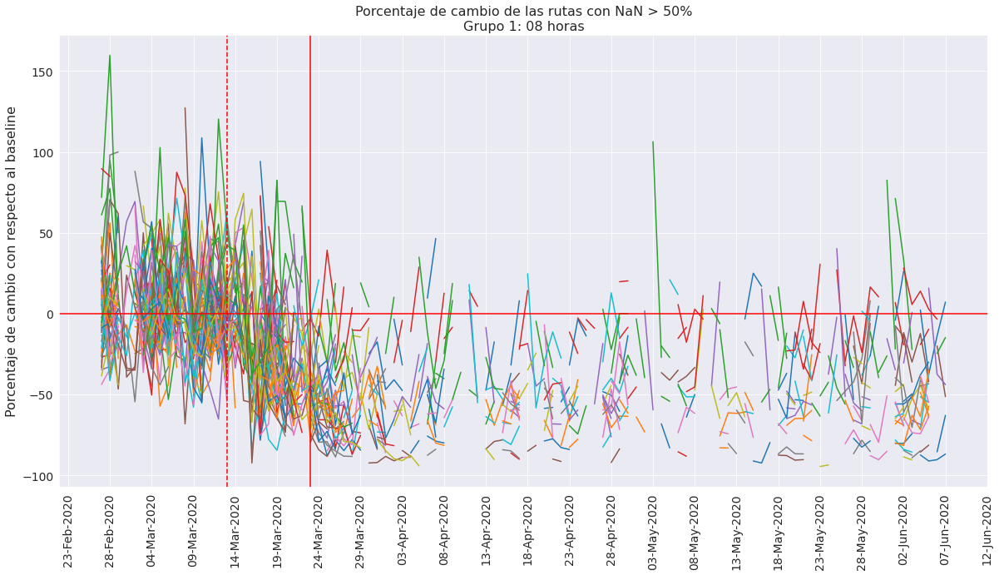

In [33]:
rutas = grupo1.index
dias = grupo1.columns
grafica_cambio_en_en_tiempo_grupos(grupo1, rutas, dias, "Grupo 1: 08 horas", 1)

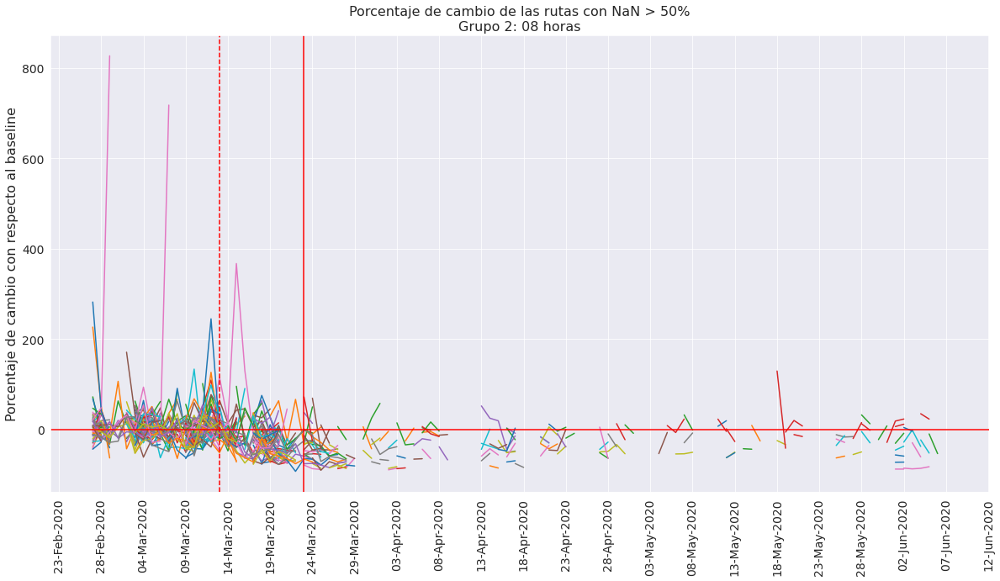

In [34]:
rutas = grupo2.index
dias = grupo2.columns
grafica_cambio_en_en_tiempo_grupos(grupo2, rutas, dias, "Grupo 2: 08 horas", 1)

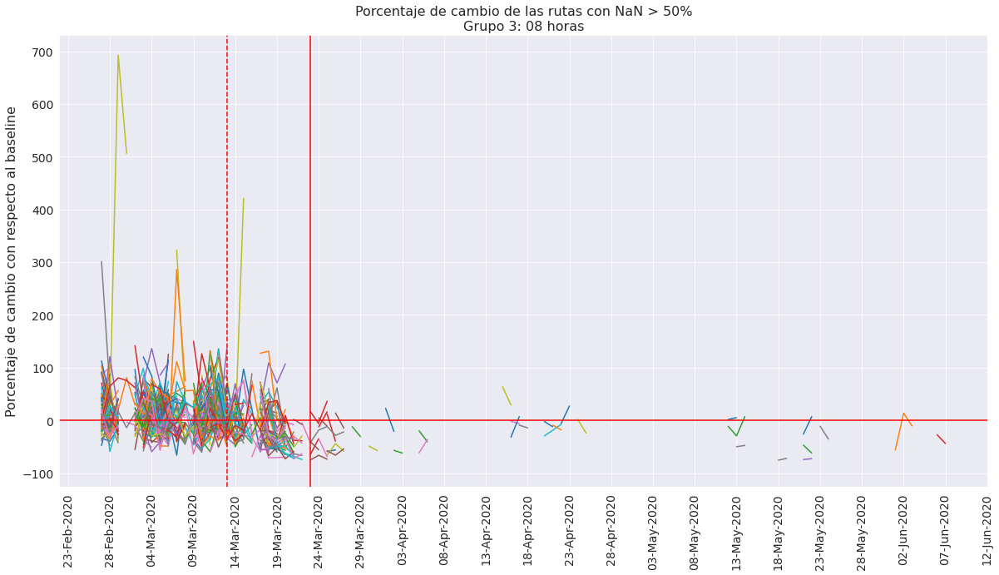

In [35]:
rutas = grupo3.index
dias = grupo3.columns
grafica_cambio_en_en_tiempo_grupos(grupo3, rutas, dias, "Grupo 3: 08 horas", 1)

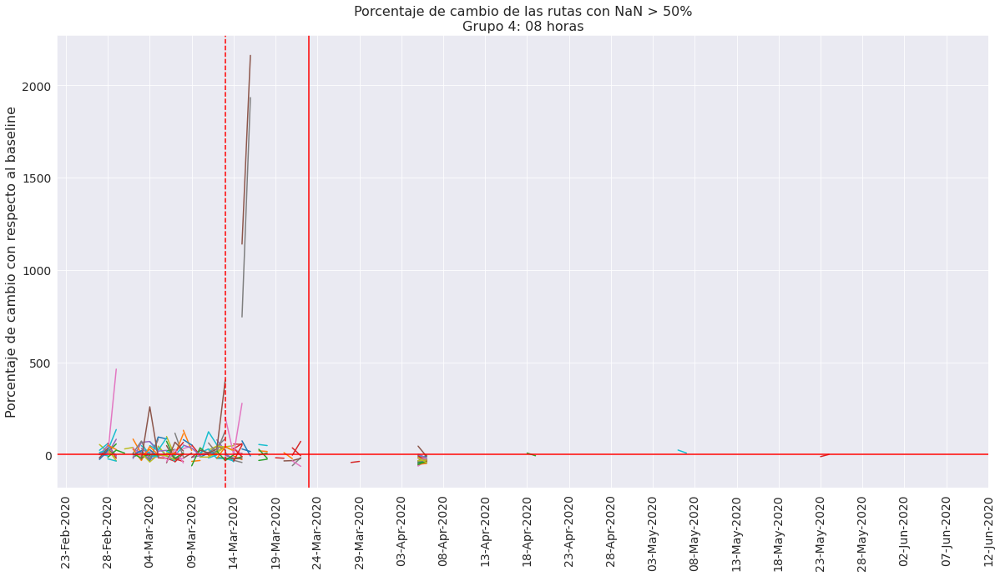

In [36]:
rutas = grupo4.index
dias = grupo4.columns
grafica_cambio_en_en_tiempo_grupos(grupo4, rutas, dias, "Grupo 4: 08 horas", 1)

### 2.3 Ventana de tiempo: 16 horas + Top 100 rutas más transitadas

In [37]:
# Rutas registradas en la ventana de las 8 horas
inter_rutas_16hr = inter_rutas.loc[inter_rutas['hr']==16 ,['ruta', 'hr', 'fecha', 'percent_change', 'crisis_people_moving']]
inter_rutas_16hr_panel = inter_rutas_16hr.groupby(['ruta', 'fecha']).mean()['percent_change'].unstack()

In [38]:
# Las 100 rutas mas transitadas 
top100_inter_16hr = inter_rutas_16hr.groupby(['ruta']).sum().sort_values(['crisis_people_moving'],ascending=False)[:100][['crisis_people_moving']]

# Porcentaje de personas que cubren las rutas top 100
(top100_inter_16hr['crisis_people_moving'].sum()/inter_rutas_16hr[['crisis_people_moving']].sum()[0])*100

# Prety print
#top100_inter_16hr.round(0).style.format('{:,}')

54.681134518468575

In [39]:
# Porcentaje de cambio en el periodo de las 100 rutas mas transitadas
top100_inter_16hr_panel = inter_rutas_16hr_panel[inter_rutas_16hr_panel.index.isin(top100_inter_16hr.index)]
avg_top100_inter_16hr = top100_inter_16hr_panel.mean(axis=1, skipna=True).sort_values(ascending=False)
#avg_top100_inter_16hr 

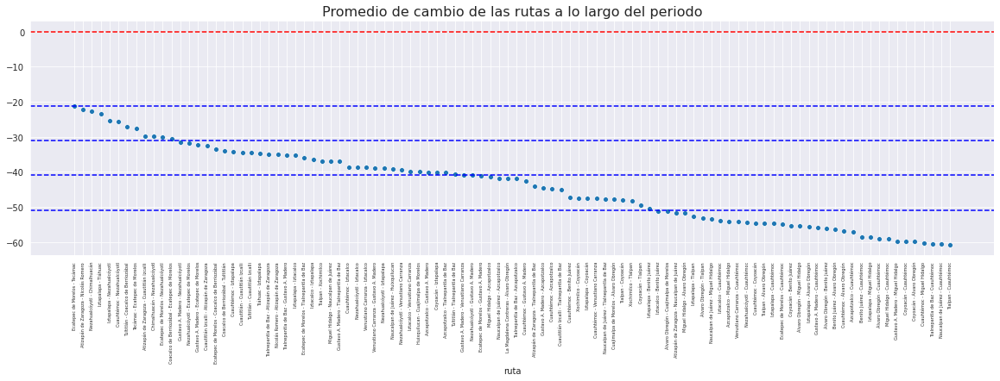

In [40]:
# Determinacion de los intervalos para los grupos
# Usamos quartiles
grafica_define_grupos(avg_top100_inter_16hr.index, avg_top100_inter_16hr, 0)

In [41]:
grupo1, grupo2, grupo3, grupo4, group_cat = asignar_rutas_en_grupos(top100_inter_16hr_panel, avg_top100_inter_16hr)

print('Grupo 1: ', group_cat[0], '\tN: ', grupo1.shape[0])
print('Grupo 2: ', group_cat[1], '\tN: ', grupo2.shape[0])
print('Grupo 3: ', group_cat[2], '\tN: ', grupo3.shape[0])
print('Grupo 4: ', group_cat[3], '\tN: ', grupo4.shape[0])

Grupo 1:  (-60.803, -50.886] 	N:  34
Grupo 2:  (-50.886, -41.009] 	N:  20
Grupo 3:  (-41.009, -31.132] 	N:  34
Grupo 4:  (-31.132, -21.254] 	N:  12


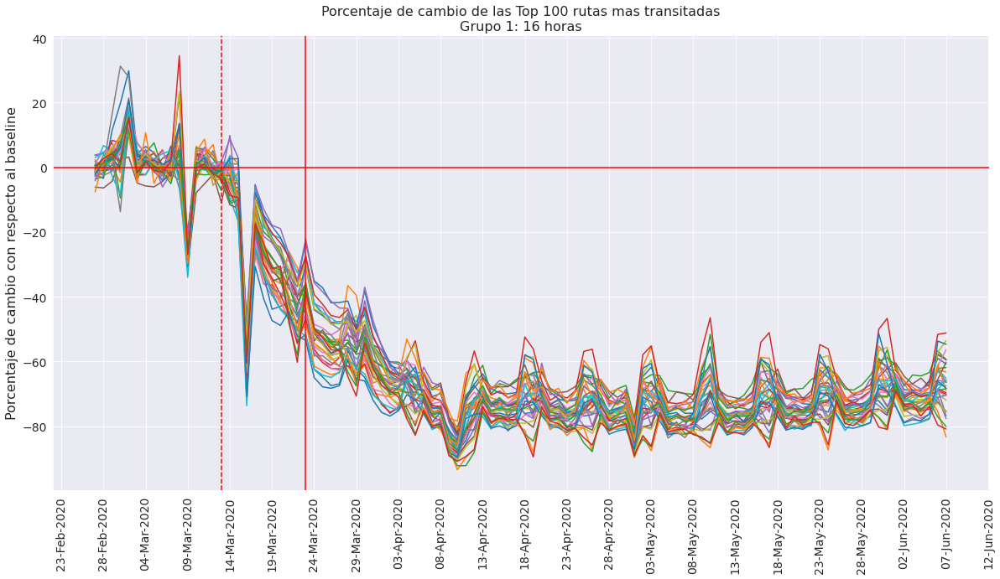

In [42]:
rutas = grupo1.index
dias = grupo1.columns
grafica_cambio_en_en_tiempo_grupos(grupo1, rutas, dias, "Grupo 1: 16 horas", 0)

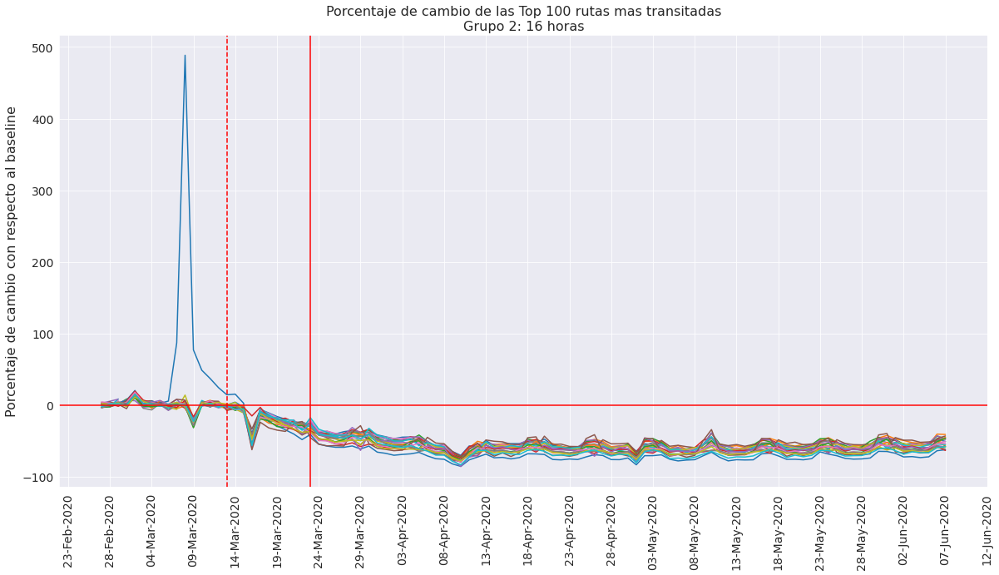

In [43]:
rutas = grupo2.index
dias = grupo2.columns
grafica_cambio_en_en_tiempo_grupos(grupo2, rutas, dias, "Grupo 2: 16 horas", 0)

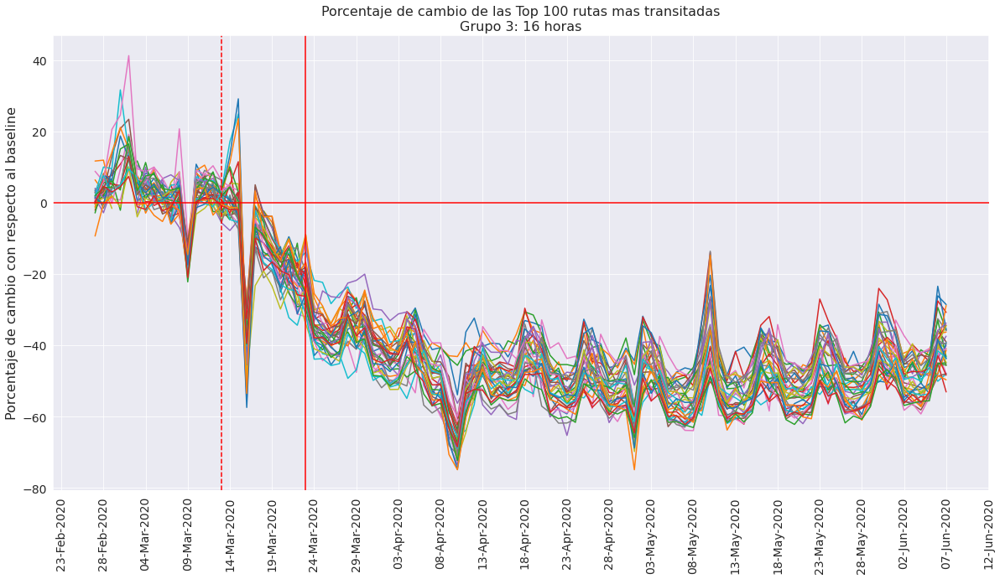

In [44]:
rutas = grupo3.index
dias = grupo3.columns
grafica_cambio_en_en_tiempo_grupos(grupo3, rutas, dias, "Grupo 3: 16 horas", 0)

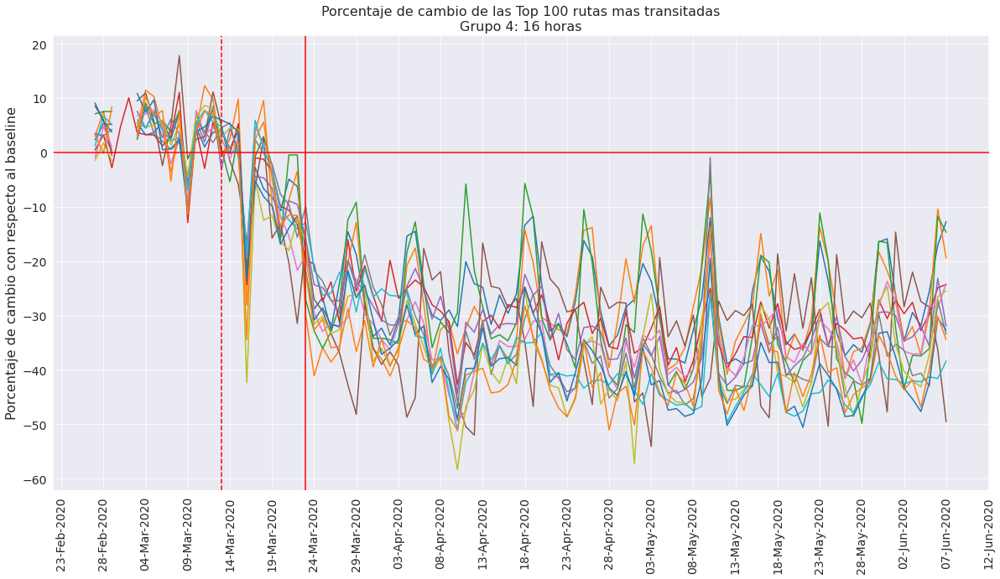

In [45]:
rutas = grupo4.index
dias = grupo4.columns
grafica_cambio_en_en_tiempo_grupos(grupo4, rutas, dias, "Grupo 4: 16 horas", 0)

### 2.4 Ventana de tiempo: 16 horas + Rutas que desaparecieron


In [46]:
# Porcentaje de NaN por ruta
inter_rutas_nan_16hr = inter_rutas_16hr_panel.isnull().mean(axis=1).sort_values(ascending=False)*100
#inter_rutas_nan_16hr

In [47]:
# Rutas con % de missing values mayores al 50%
inter_rutas_16hr_desaparecidas_index = inter_rutas_nan_16hr[inter_rutas_nan_16hr.values>50].index
inter_rutas_16hr_desaparecidas = inter_rutas_16hr_panel.loc[inter_rutas_16hr_desaparecidas_index]

print("Rutas con % de nan > 50: ", inter_rutas_16hr_desaparecidas.shape[0])

Rutas con % de nan > 50:  398


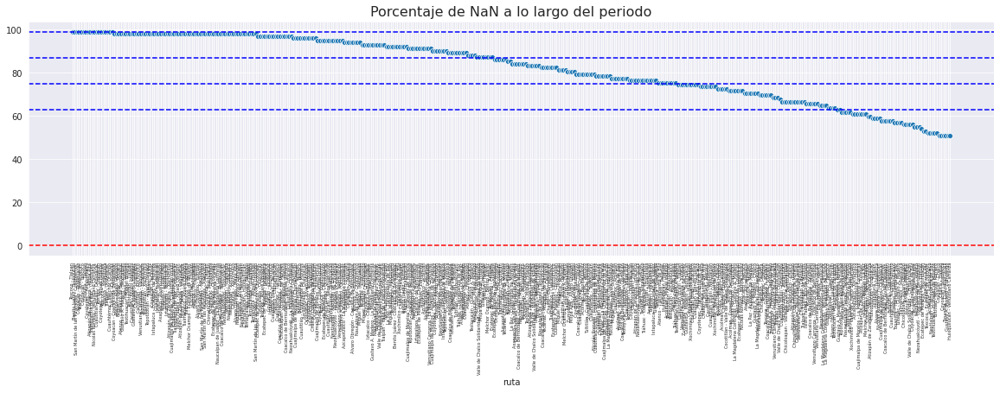

In [48]:
# Determinacion de los intervalos para los grupos
# Usamos quartiles
grafica_define_grupos(inter_rutas_16hr_desaparecidas_index, inter_rutas_nan_16hr.loc[inter_rutas_16hr_desaparecidas_index], 1)

In [49]:
grupo1, grupo2, grupo3, grupo4, group_cat = asignar_rutas_en_grupos(inter_rutas_16hr_desaparecidas, inter_rutas_nan_16hr.loc[inter_rutas_16hr_desaparecidas_index])

print('Grupo 1: ', group_cat[0], '\tN: ', grupo1.shape[0])
print('Grupo 2: ', group_cat[1], '\tN: ', grupo2.shape[0])
print('Grupo 3: ', group_cat[2], '\tN: ', grupo3.shape[0])
print('Grupo 4: ', group_cat[3], '\tN: ', grupo4.shape[0])

Grupo 1:  (50.932, 62.99] 	N:  52
Grupo 2:  (62.99, 75.0] 	N:  72
Grupo 3:  (75.0, 87.01] 	N:  83
Grupo 4:  (87.01, 99.02] 	N:  191


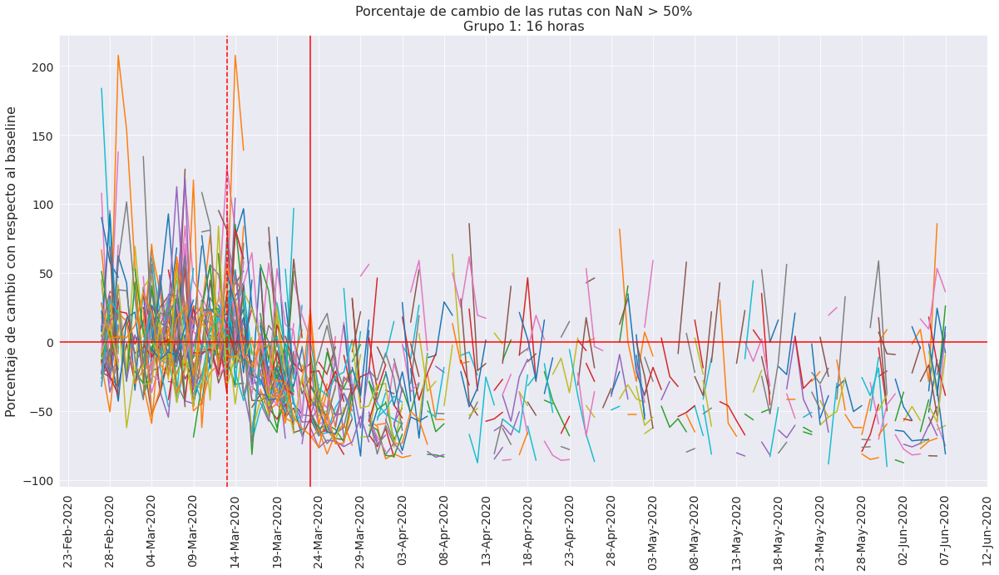

In [50]:
rutas = grupo1.index
dias = grupo1.columns
grafica_cambio_en_en_tiempo_grupos(grupo1, rutas, dias, "Grupo 1: 16 horas", 1)

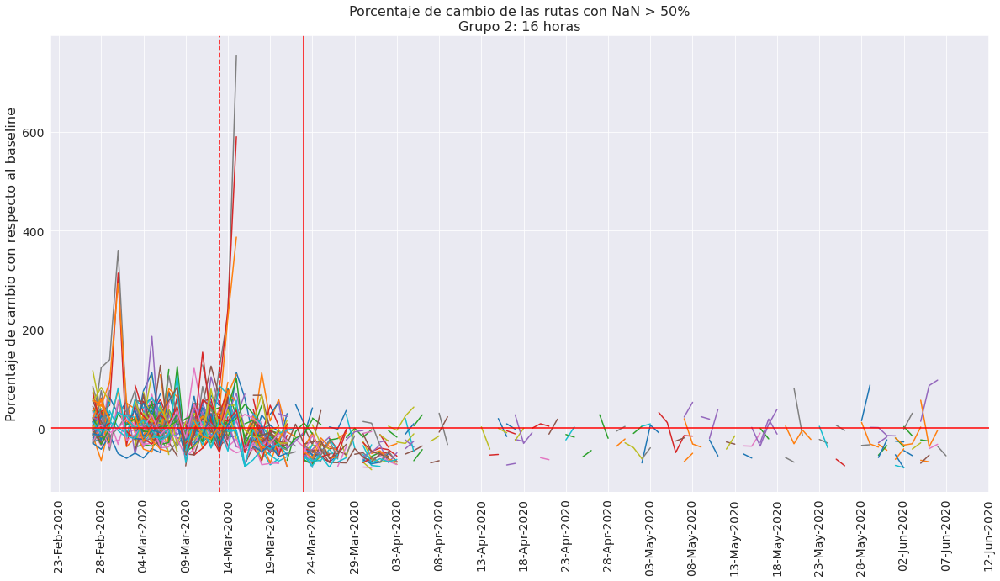

In [51]:
rutas = grupo2.index
dias = grupo2.columns
grafica_cambio_en_en_tiempo_grupos(grupo2, rutas, dias, "Grupo 2: 16 horas", 1)

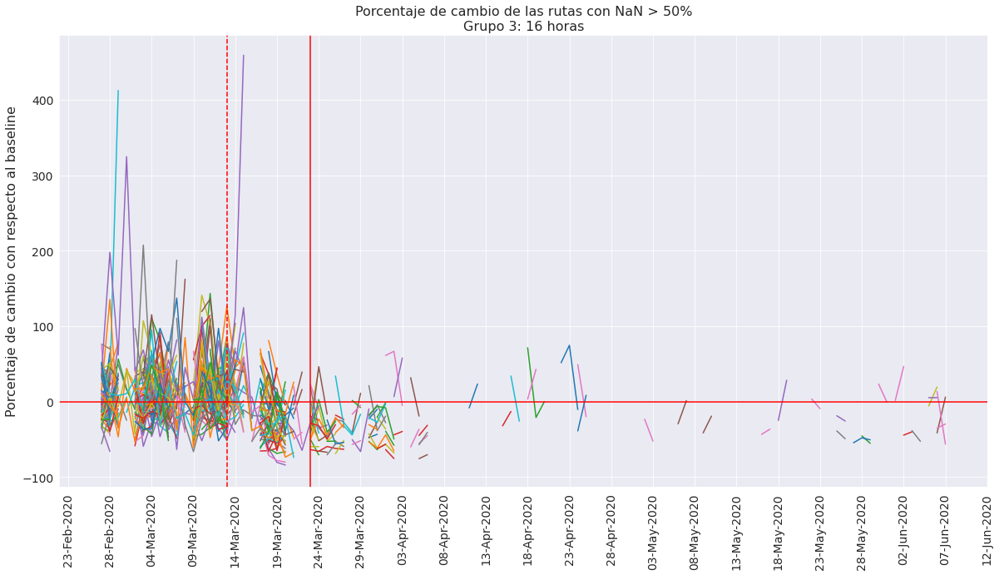

In [52]:
rutas = grupo3.index
dias = grupo3.columns
grafica_cambio_en_en_tiempo_grupos(grupo3, rutas, dias, "Grupo 3: 16 horas", 1)

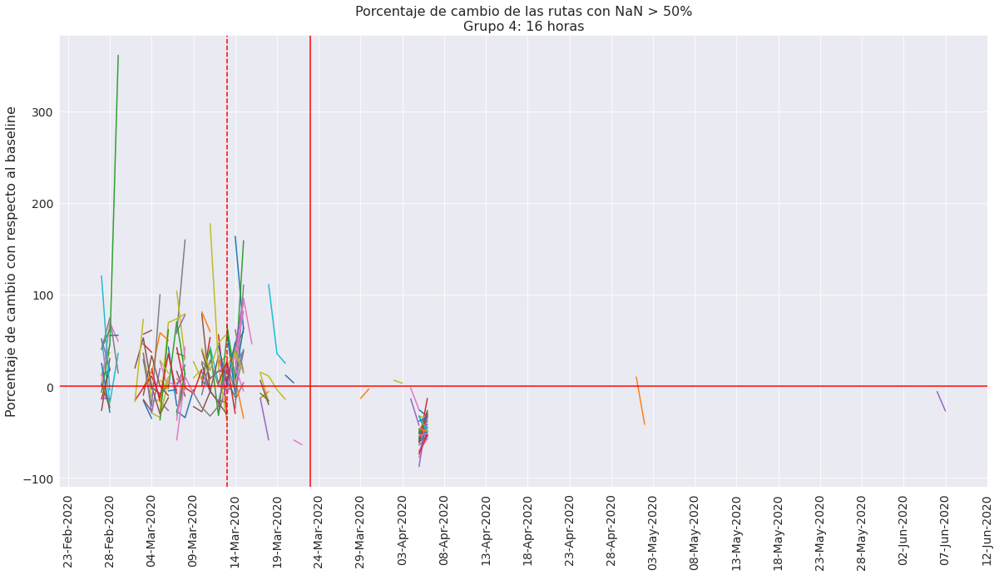

In [53]:
rutas = grupo4.index
dias = grupo4.columns
grafica_cambio_en_en_tiempo_grupos(grupo4, rutas, dias, "Grupo 4: 16 horas", 1)

### 2.5 Ventana de tiempo: 16 horas + Top 100 rutas más transitadas

In [54]:
# Rutas registradas en la ventana de las 8 horas
inter_rutas_00hr = inter_rutas.loc[inter_rutas['hr']==0 ,['ruta', 'hr', 'fecha', 'percent_change', 'crisis_people_moving']]
inter_rutas_00hr_panel = inter_rutas_00hr.groupby(['ruta', 'fecha']).mean()['percent_change'].unstack()

In [55]:
# Las 100 rutas mas transitadas 
top100_inter_00hr = inter_rutas_00hr.groupby(['ruta']).sum().sort_values(['crisis_people_moving'],ascending=False)[:100][['crisis_people_moving']]

# Porcentaje de personas que cubren las rutas top 100
(top100_inter_00hr['crisis_people_moving'].sum()/inter_rutas_00hr[['crisis_people_moving']].sum()[0])*100

# Prety print
#top100_inter_00hr.round(0).style.format('{:,}')

53.99479379386839

In [56]:
# Porcentaje de cambio en el periodo de las 100 rutas mas transitadas
top100_inter_00hr_panel = inter_rutas_00hr_panel[inter_rutas_00hr_panel.index.isin(top100_inter_00hr.index)]
avg_top100_inter_00hr = top100_inter_00hr_panel.mean(axis=1, skipna=True).sort_values(ascending=False)
#avg_top100_inter_00hr

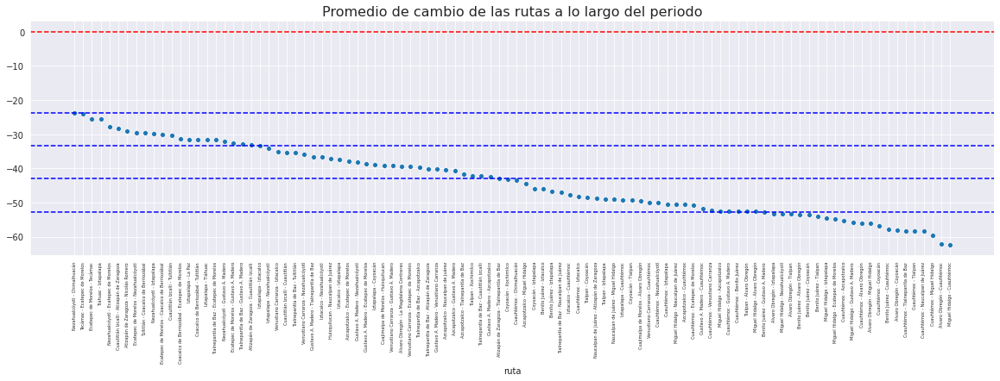

In [57]:
# Determinacion de los intervalos para los grupos
# Usamos quartiles
grafica_define_grupos(avg_top100_inter_00hr.index, avg_top100_inter_00hr, 0)

In [58]:
grupo1, grupo2, grupo3, grupo4, group_cat = asignar_rutas_en_grupos(top100_inter_00hr_panel, avg_top100_inter_00hr)

print('Grupo 1: ', group_cat[0], '\tN: ', grupo1.shape[0])
print('Grupo 2: ', group_cat[1], '\tN: ', grupo2.shape[0])
print('Grupo 3: ', group_cat[2], '\tN: ', grupo3.shape[0])
print('Grupo 4: ', group_cat[3], '\tN: ', grupo4.shape[0])

Grupo 1:  (-62.355, -52.663] 	N:  22
Grupo 2:  (-52.663, -43.01] 	N:  29
Grupo 3:  (-43.01, -33.356] 	N:  27
Grupo 4:  (-33.356, -23.703] 	N:  22


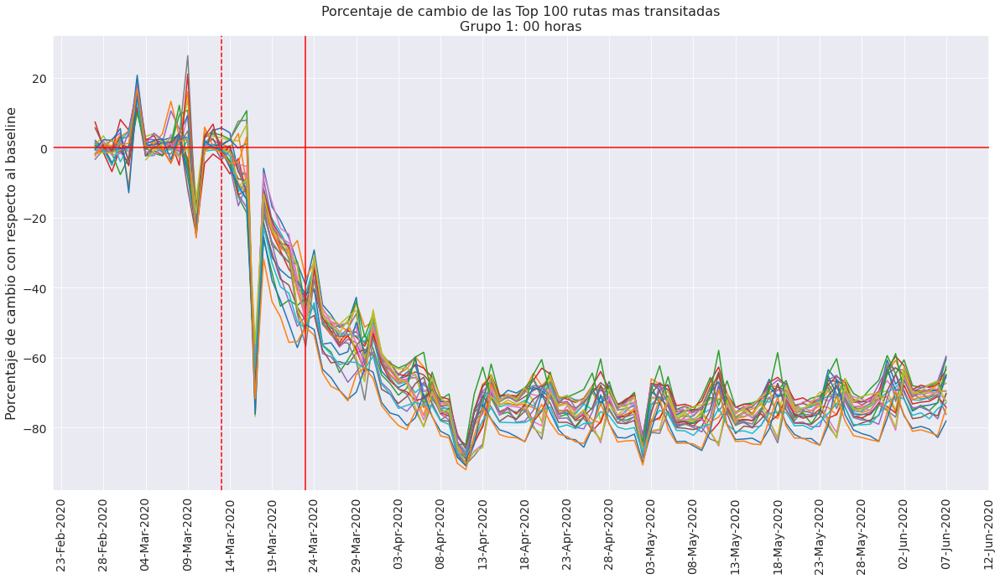

In [59]:
rutas = grupo1.index
dias = grupo1.columns
grafica_cambio_en_en_tiempo_grupos(grupo1, rutas, dias, "Grupo 1: 00 horas", 0)

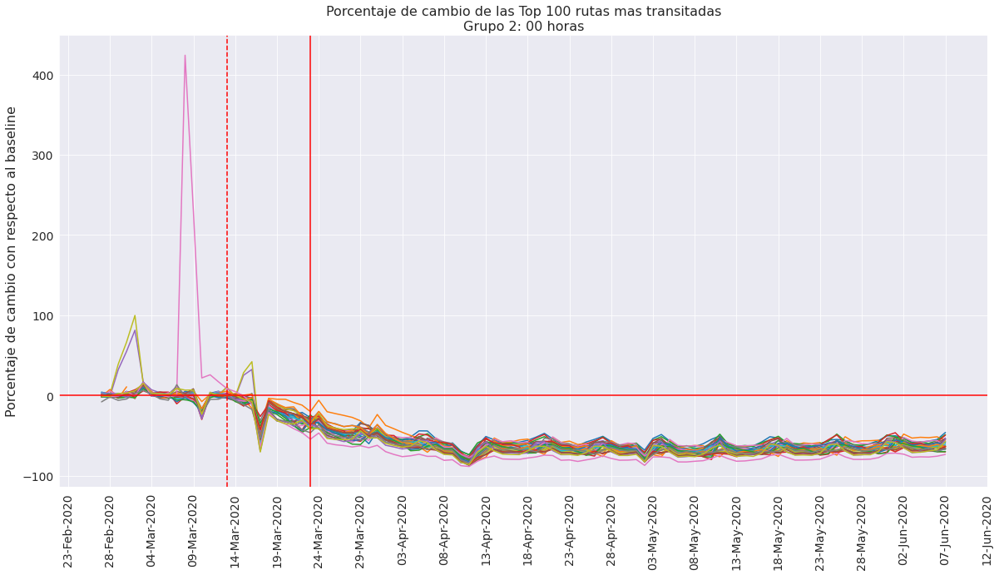

In [60]:
rutas = grupo2.index
dias = grupo2.columns
grafica_cambio_en_en_tiempo_grupos(grupo2, rutas, dias, "Grupo 2: 00 horas", 0)

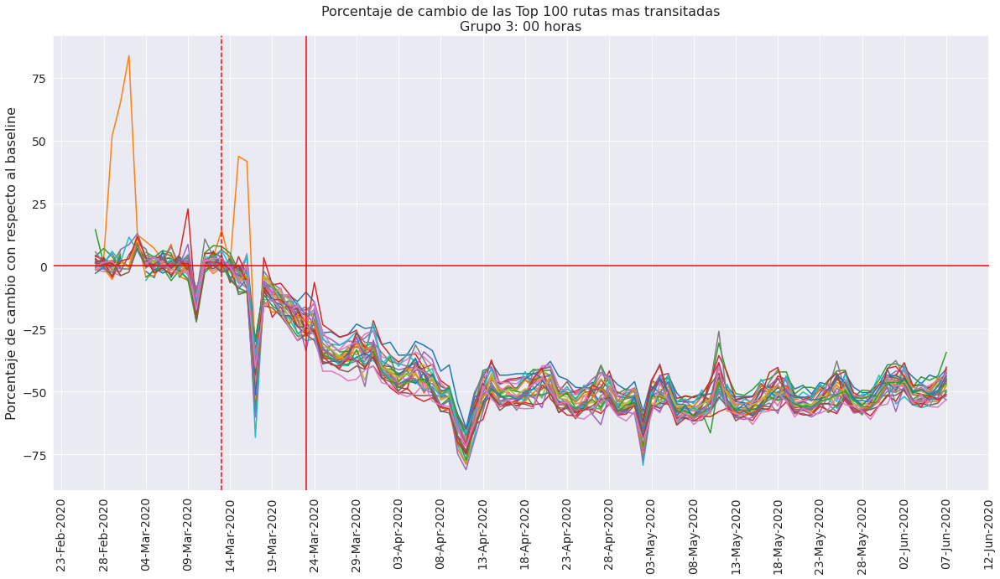

In [61]:
rutas = grupo3.index
dias = grupo3.columns
grafica_cambio_en_en_tiempo_grupos(grupo3, rutas, dias, "Grupo 3: 00 horas", 0)

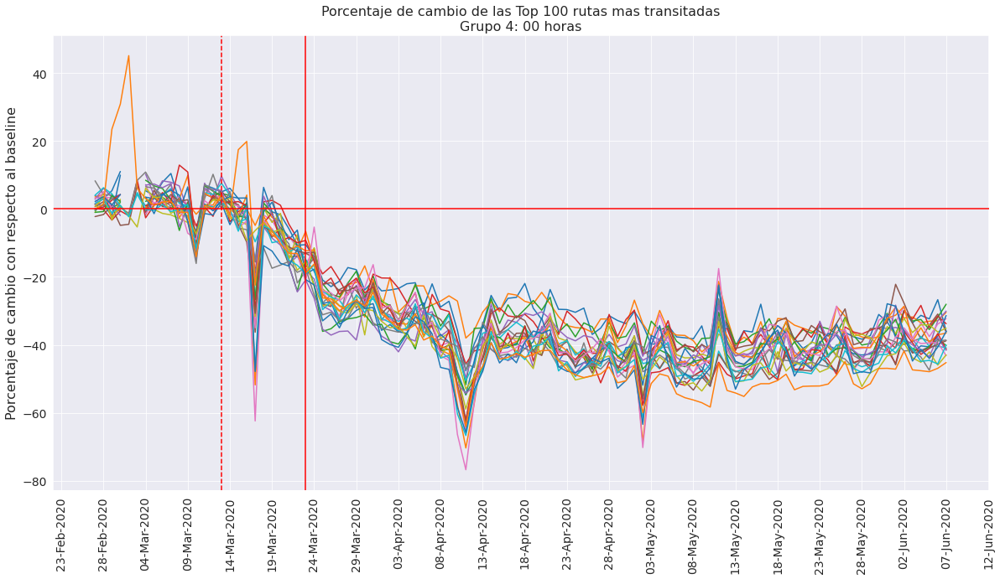

In [62]:
rutas = grupo4.index
dias = grupo4.columns
grafica_cambio_en_en_tiempo_grupos(grupo4, rutas, dias, "Grupo 4: 00 horas", 0)

### 2.6 Ventana de tiempo: 16 horas + Rutas que desaparecieron


In [63]:
# Porcentaje de NaN por ruta
inter_rutas_nan_00hr = inter_rutas_00hr_panel.isnull().mean(axis=1).sort_values(ascending=False)*100
#inter_rutas_nan_00hr

In [64]:
# Rutas con % de missing values mayores al 50%
inter_rutas_00hr_desaparecidas_index = inter_rutas_nan_00hr[inter_rutas_nan_00hr.values>50].index
inter_rutas_00hr_desaparecidas = inter_rutas_00hr_panel.loc[inter_rutas_00hr_desaparecidas_index]

print("Rutas con % de nan > 50: ", inter_rutas_00hr_desaparecidas.shape[0])

Rutas con % de nan > 50:  439


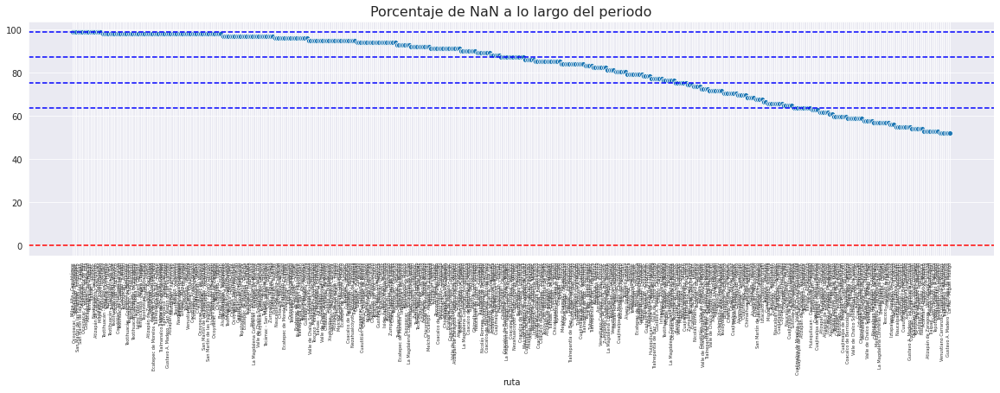

In [65]:
# Determinacion de los intervalos para los grupos
# Usamos quartiles
grafica_define_grupos(inter_rutas_00hr_desaparecidas_index, inter_rutas_nan_00hr.loc[inter_rutas_00hr_desaparecidas_index], 1)

In [66]:
grupo1, grupo2, grupo3, grupo4, group_cat = asignar_rutas_en_grupos(inter_rutas_00hr_desaparecidas, inter_rutas_nan_00hr.loc[inter_rutas_00hr_desaparecidas_index])

print('Grupo 1: ', group_cat[0], '\tN: ', grupo1.shape[0])
print('Grupo 2: ', group_cat[1], '\tN: ', grupo2.shape[0])
print('Grupo 3: ', group_cat[2], '\tN: ', grupo3.shape[0])
print('Grupo 4: ', group_cat[3], '\tN: ', grupo4.shape[0])

Grupo 1:  (51.914, 63.725] 	N:  79
Grupo 2:  (63.725, 75.49] 	N:  59
Grupo 3:  (75.49, 87.255] 	N:  87
Grupo 4:  (87.255, 99.02] 	N:  214


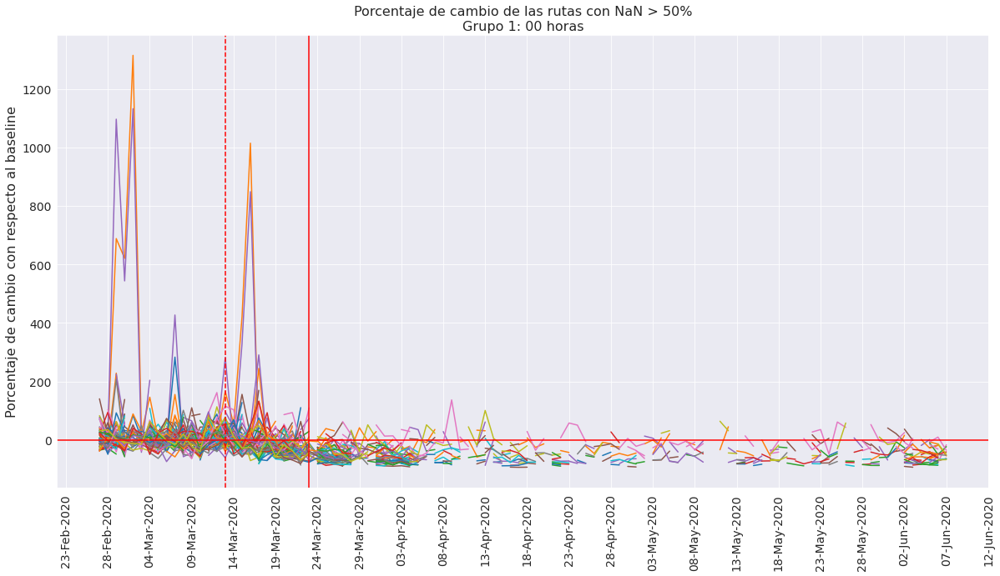

In [67]:
rutas = grupo1.index
dias = grupo1.columns
grafica_cambio_en_en_tiempo_grupos(grupo1, rutas, dias, "Grupo 1: 00 horas", 1)

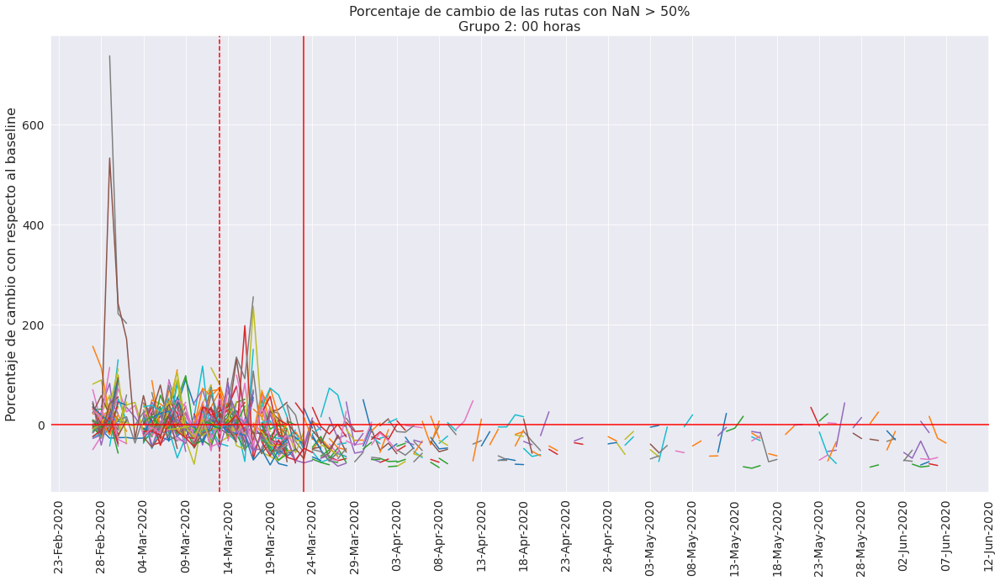

In [68]:
rutas = grupo2.index
dias = grupo2.columns
grafica_cambio_en_en_tiempo_grupos(grupo2, rutas, dias, "Grupo 2: 00 horas", 1)

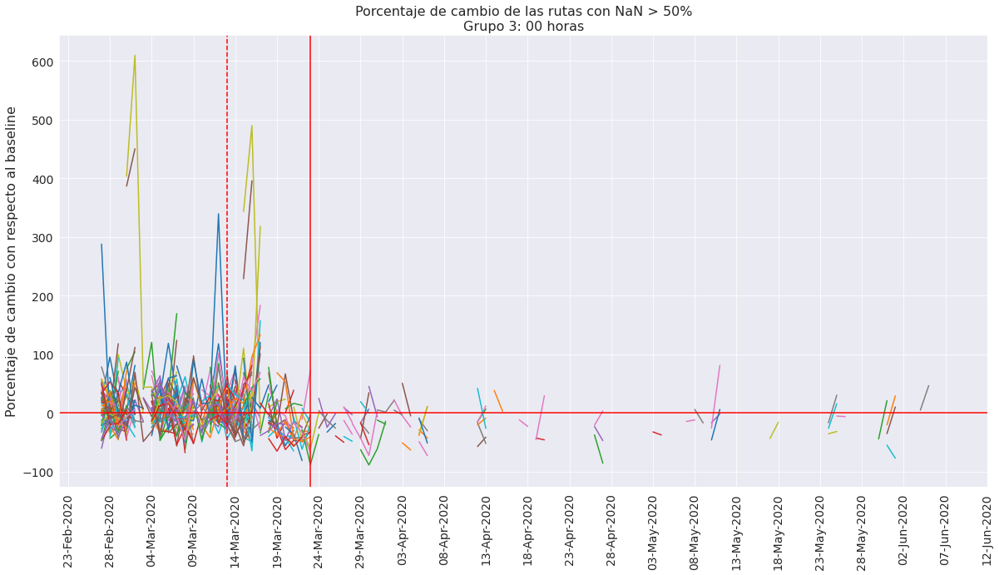

In [69]:
rutas = grupo3.index
dias = grupo3.columns
grafica_cambio_en_en_tiempo_grupos(grupo3, rutas, dias, "Grupo 3: 00 horas", 1)

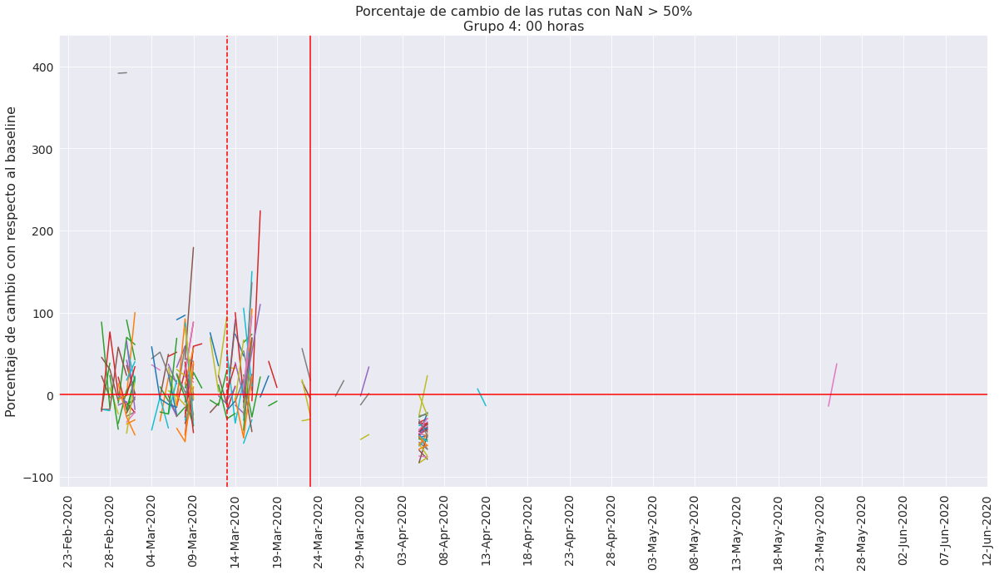

In [70]:
rutas = grupo4.index
dias = grupo4.columns
grafica_cambio_en_en_tiempo_grupos(grupo4, rutas, dias, "Grupo 4: 00 horas", 1)


## 3. Análisis de rutas por día de la semana

Nuevamente, nos enfocamos solo a las Inter-rutas.

### 3.1. Ventana: 08 horas

Para cada dia de la semana, tomamos las 100 rutas mas transitadas y vemos como cambia su movilidad

In [71]:
lista_dias = ['Lunes', 'Martes', 'Miércoles', 'Jueves', 'Viernes', 'Sábado', 'Domingo']

In [72]:
# df por dia de la semana para las 08 horas
ruta_8hr_dias = []

for i,dia in enumerate(lista_dias):
    df = inter_rutas[(inter_rutas['dia_semana']==dia) & (inter_rutas['hr']==8)][['ruta','percent_change', 'fecha']].groupby(['ruta','fecha']).mean().unstack()
    ruta_8hr_dias.append(df)

In [73]:
#ruta_8hr_dias[0]
for i in range(0,7):
    print("numero de rutas para el dia {}: {:,}".format(lista_dias[i], ruta_8hr_dias[i].shape[0]))

numero de rutas para el dia Lunes: 1,019
numero de rutas para el dia Martes: 998
numero de rutas para el dia Miércoles: 1,001
numero de rutas para el dia Jueves: 1,010
numero de rutas para el dia Viernes: 1,016
numero de rutas para el dia Sábado: 909
numero de rutas para el dia Domingo: 883


In [74]:
#Promedio de rutas por dia de la semana, cada semana
df = pd.DataFrame()
for i,dia in enumerate(lista_dias):
    df[dia] = ruta_8hr_dias[i].mean(axis=0).reset_index(drop=True)
    #df.plot(y=dia)

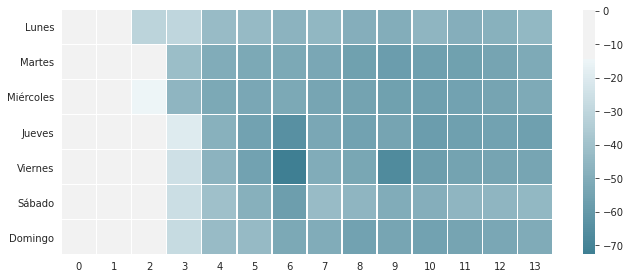

In [75]:
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 20, sep=50, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(df.transpose(), cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

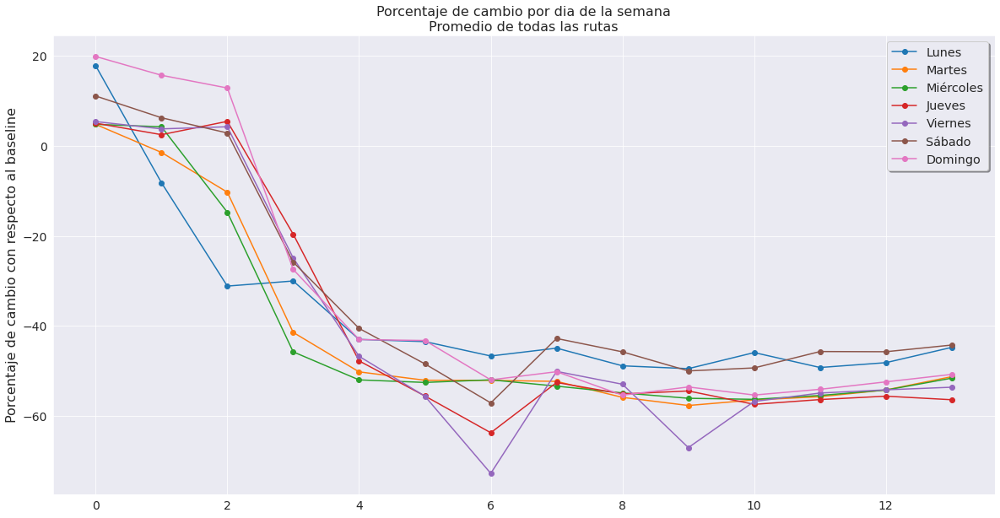

In [76]:
sns.set_style("darkgrid")
fig, ax = plt.subplots(figsize=(20,10))

for dia in lista_dias:
    ax.plot(df[dia], marker='o', label=dia)

ax.legend(loc='upper right', shadow=True, fontsize='x-large')

plt.title('Porcentaje de cambio por dia de la semana\nPromedio de todas las rutas', fontsize='16')
plt.ylabel('Numero de semanas', fontsize='16')
plt.ylabel('Porcentaje de cambio con respecto al baseline', fontsize='16')

plt.xticks(fontsize='14')
plt.yticks(fontsize='14')
plt.show()

### 3.2. Ventana: 08 horas + Top 100 rutas mas transitadas

In [77]:
#rutas = ruta_dia_top100.index
#dias = ruta_dia_top100.columns.get_level_values(1)

def grafica_cambio_en_en_tiempo_grupos_dia_semana(df_grupo, rutas, dias, group_name, flag):
    #df_grupo: df que contiene las rutas
    #rutas: array con los nombres de las rutas
    #dias: array con los dias del periodo
    #group_name: str con el nombre del grupo
    #flag: para cambiar el titulo
    sns.set_style("darkgrid")
    fig, ax = plt.subplots(figsize=(20,10))
    
    for ruta in rutas:
        ax.plot(df_grupo.loc[ruta, ('percent_change',)])
    plt.axhline(y=0, color='red', linestyle='solid')
    
    myFmt = DateFormatter("%d-%b-%Y")
    ax.xaxis.set_major_formatter(myFmt)
    ax.xaxis.set_major_locator(DayLocator(interval=5))
    ax.xaxis.set_minor_locator(DayLocator())
    
    if flag == 0:
        plt.title('Porcentaje de cambio de las Top 100 rutas mas transitadas\n{}'.format(group_name), fontsize='16')
    else:
        plt.title('Porcentaje de cambio de las rutas con NaN > 50%\n{}'.format(group_name), fontsize='16')
        
    plt.ylabel('Porcentaje de cambio con respecto al baseline', fontsize='16')
    
    plt.axvline(x=datetime.datetime(2020, 3, 23), color='red')
    plt.axvline(x=datetime.datetime(2020, 3, 13), color='red', linestyle='dashed')
    
    plt.xticks(fontsize='14', rotation='vertical')
    plt.yticks(fontsize='14')
    plt.show()

Grupo 1:  (-62.966, -52.665] 	N:  13
Grupo 2:  (-52.665, -42.406] 	N:  34
Grupo 3:  (-42.406, -32.146] 	N:  36
Grupo 4:  (-32.146, -21.886] 	N:  17


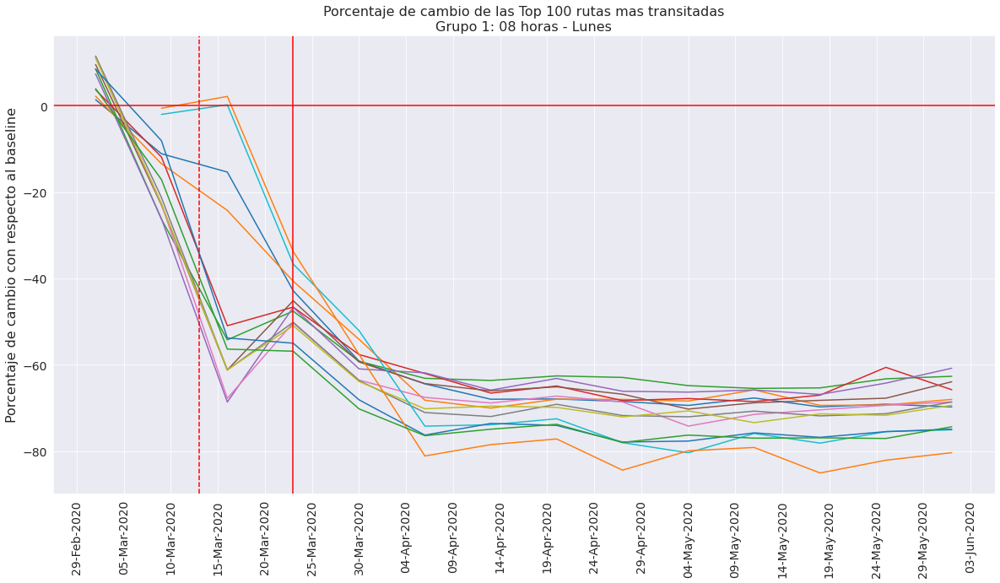

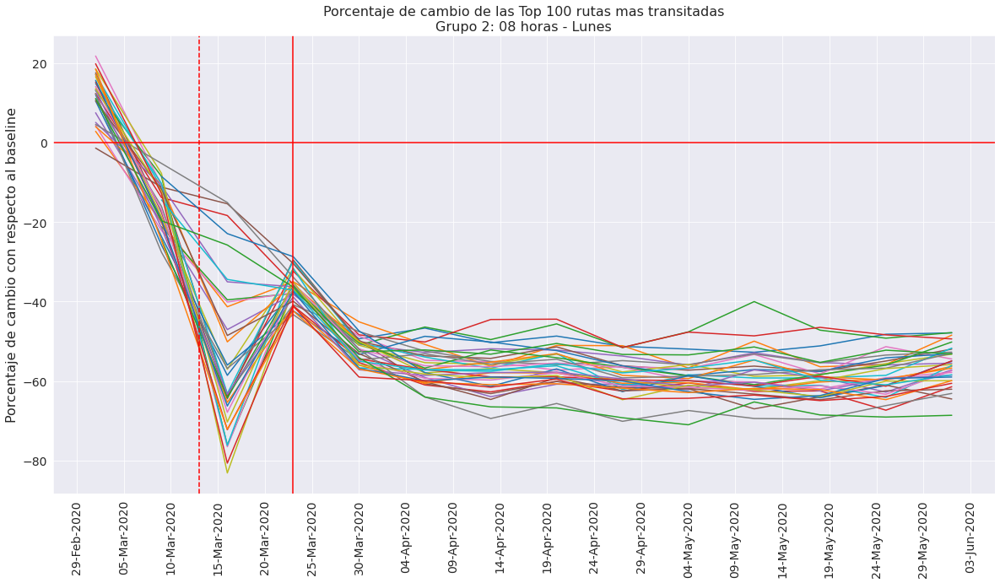

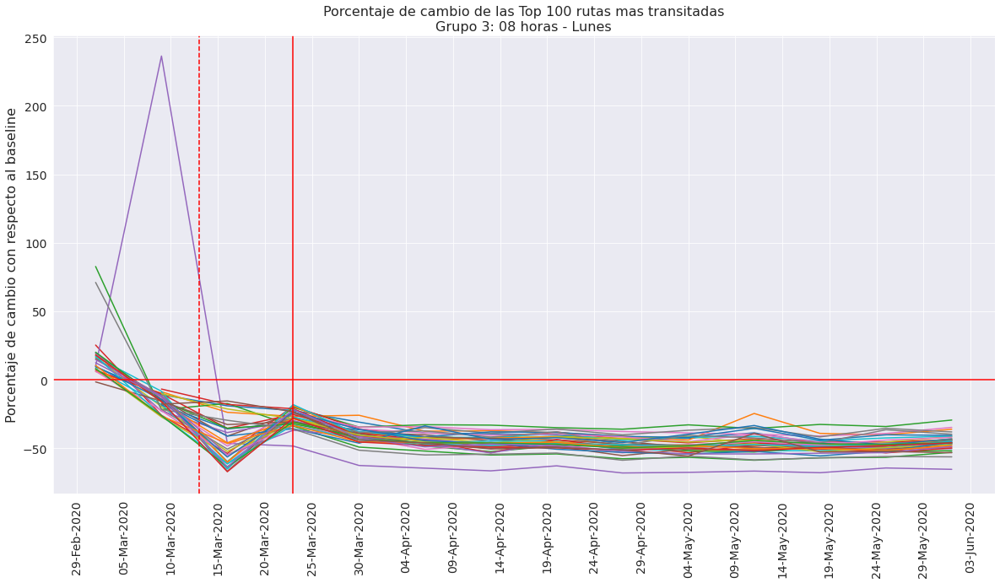

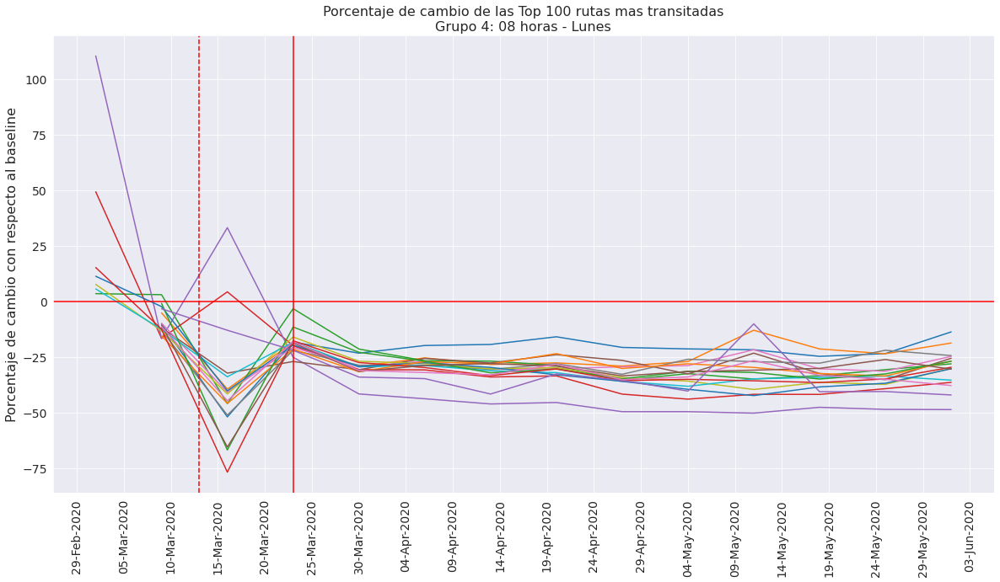

Grupo 1:  (-65.954, -55.033] 	N:  20
Grupo 2:  (-55.033, -44.156] 	N:  35
Grupo 3:  (-44.156, -33.279] 	N:  33
Grupo 4:  (-33.279, -22.402] 	N:  12


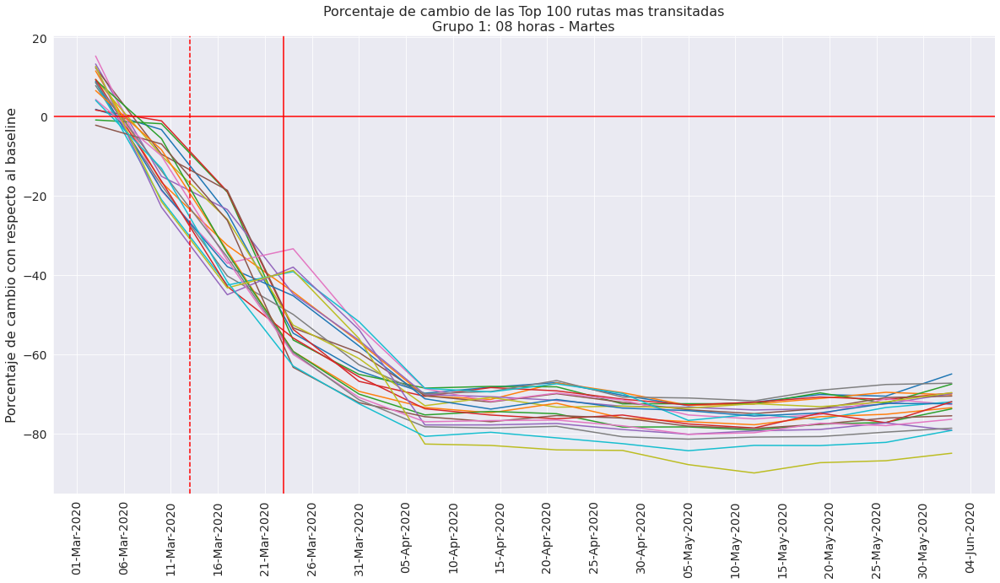

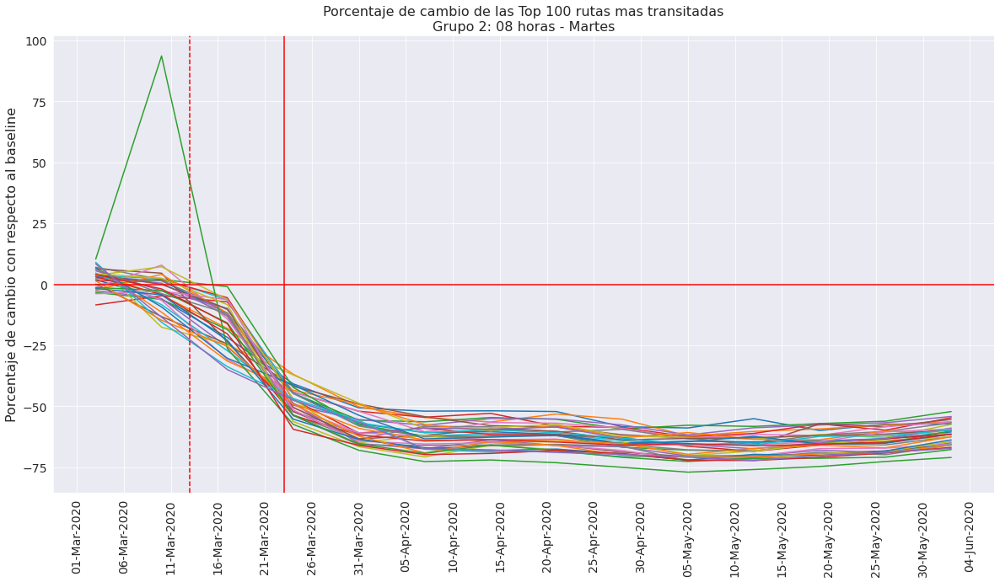

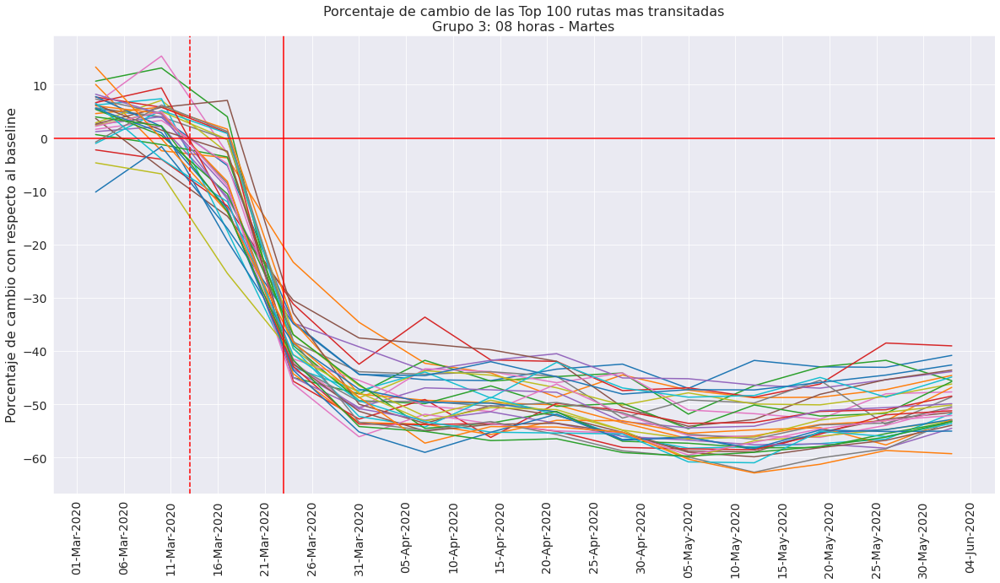

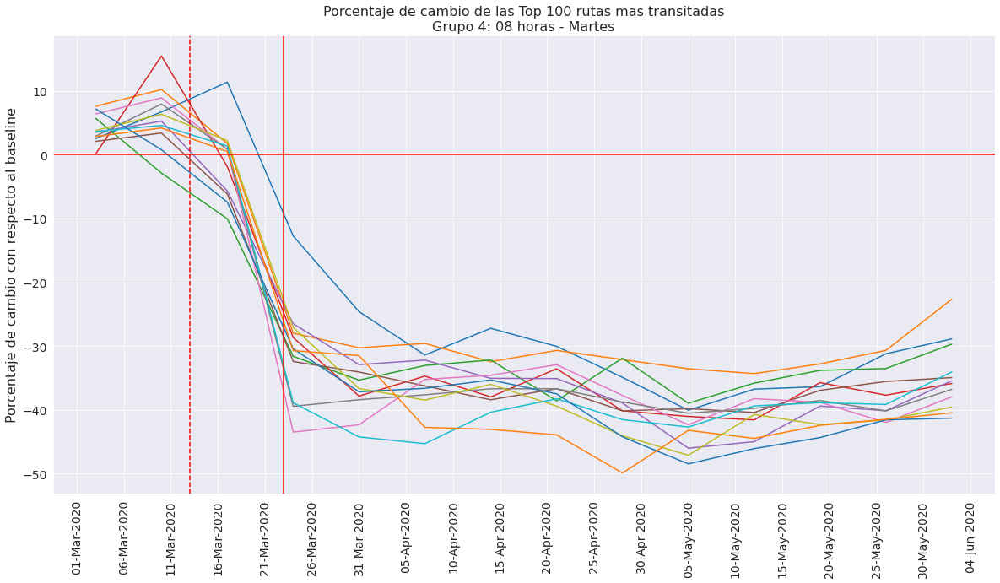

Grupo 1:  (-66.427, -55.969] 	N:  17
Grupo 2:  (-55.969, -45.552] 	N:  36
Grupo 3:  (-45.552, -35.136] 	N:  30
Grupo 4:  (-35.136, -24.719] 	N:  17


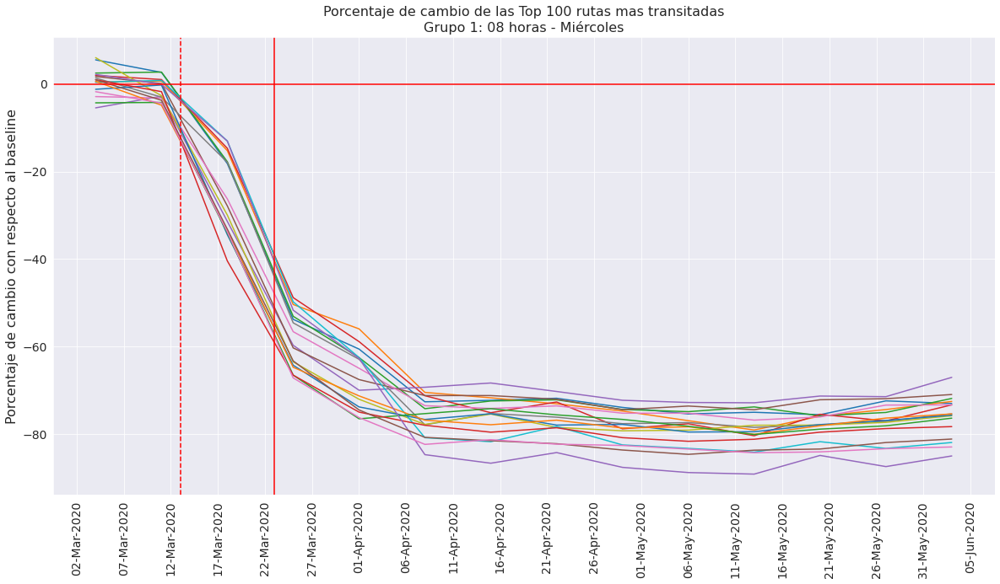

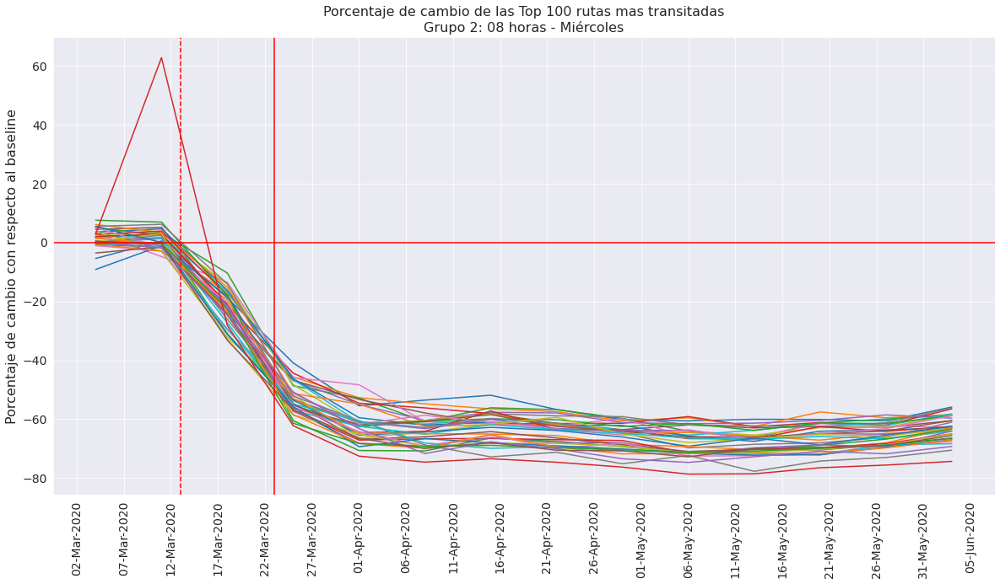

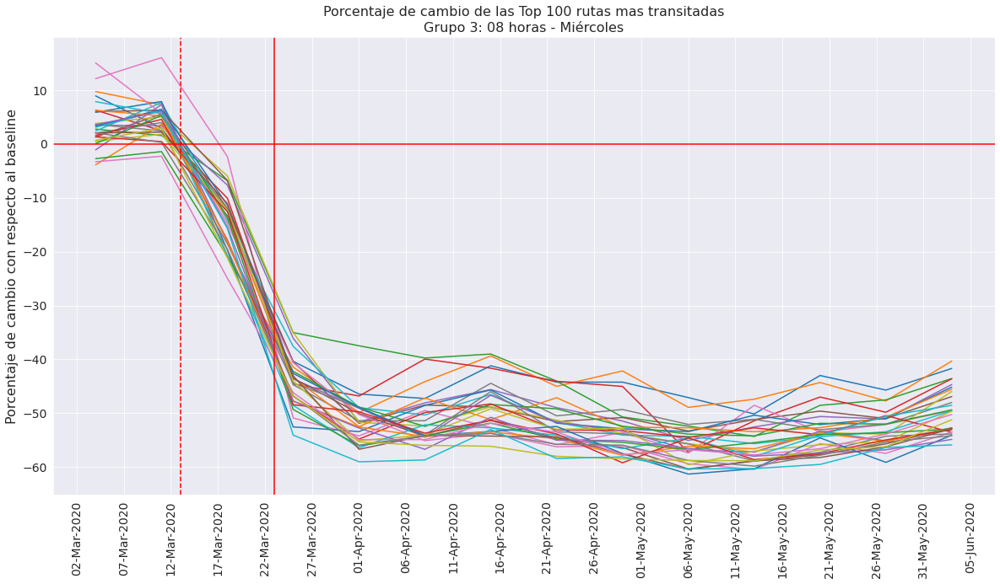

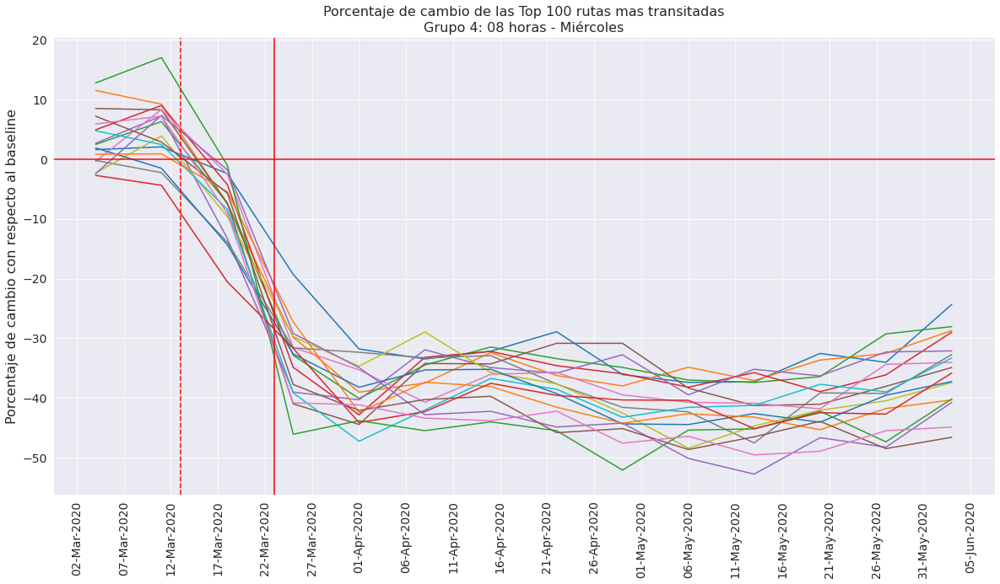

Grupo 1:  (-63.366, -53.806] 	N:  22
Grupo 2:  (-53.806, -44.283] 	N:  30
Grupo 3:  (-44.283, -34.761] 	N:  31
Grupo 4:  (-34.761, -25.238] 	N:  17


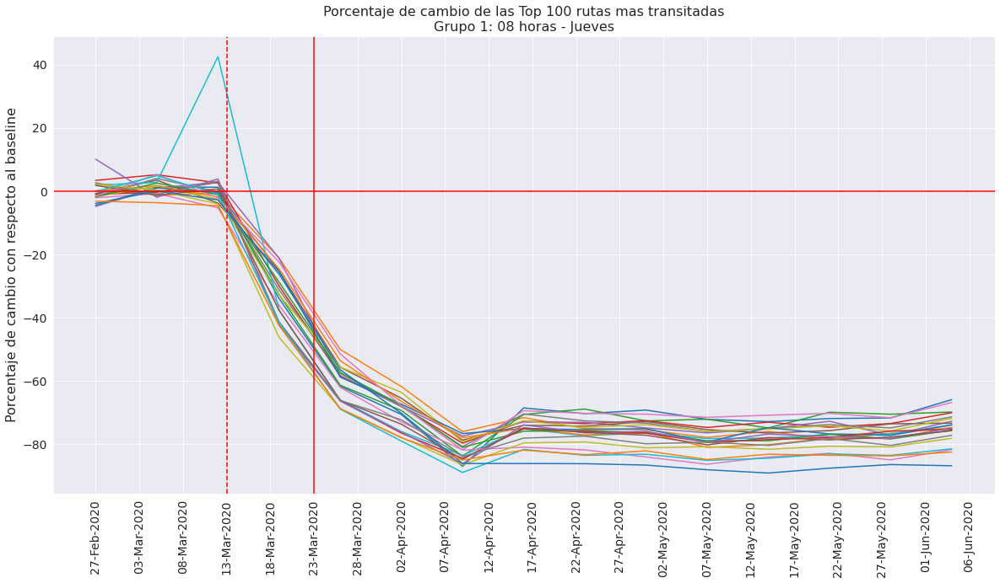

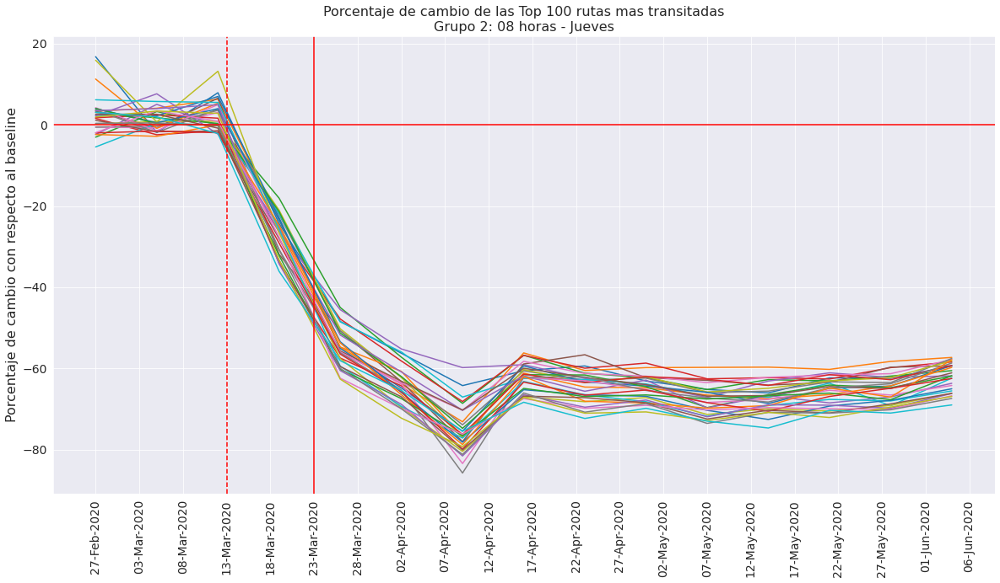

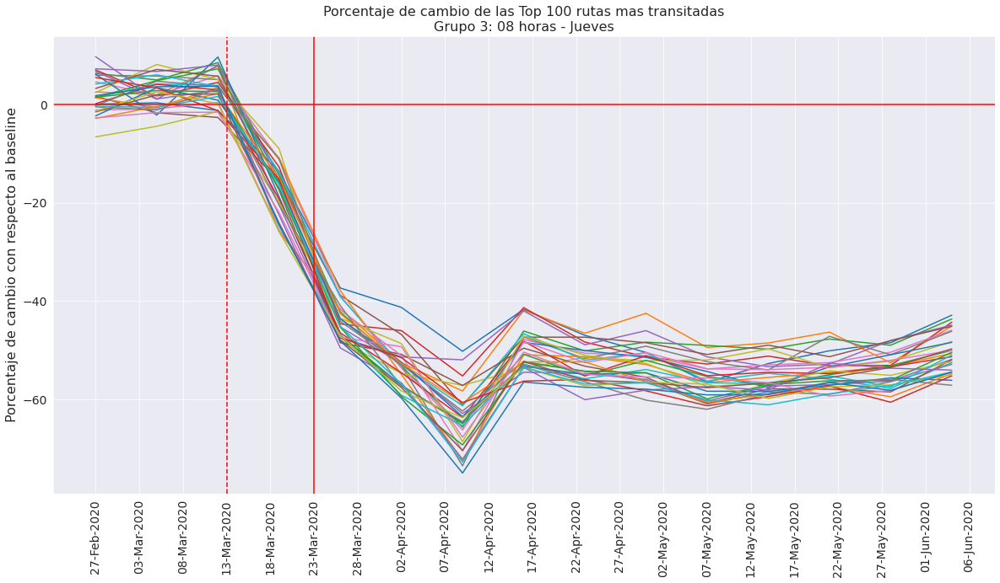

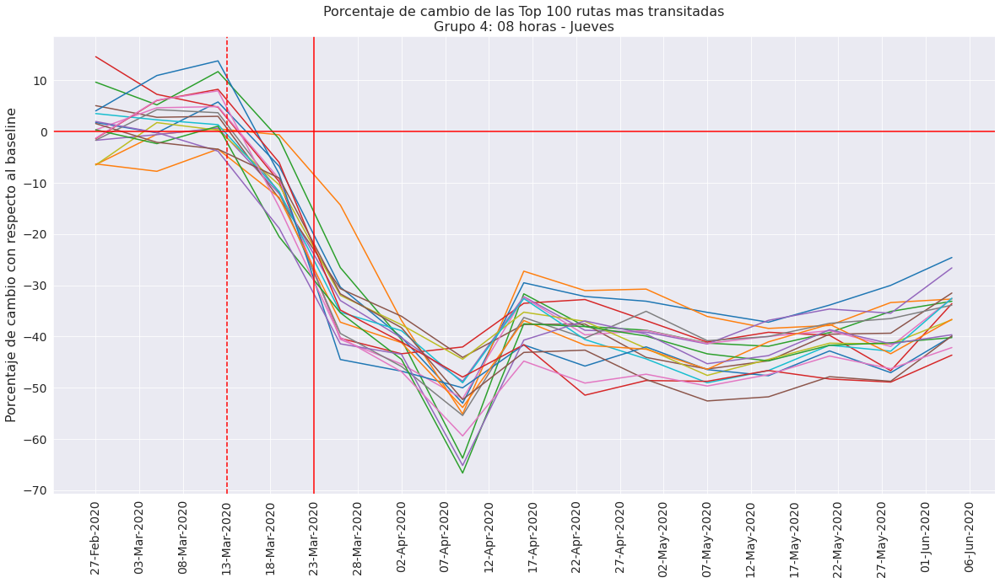

Grupo 1:  (-64.926, -55.568] 	N:  20
Grupo 2:  (-55.568, -46.247] 	N:  29
Grupo 3:  (-46.247, -36.926] 	N:  32
Grupo 4:  (-36.926, -27.605] 	N:  19


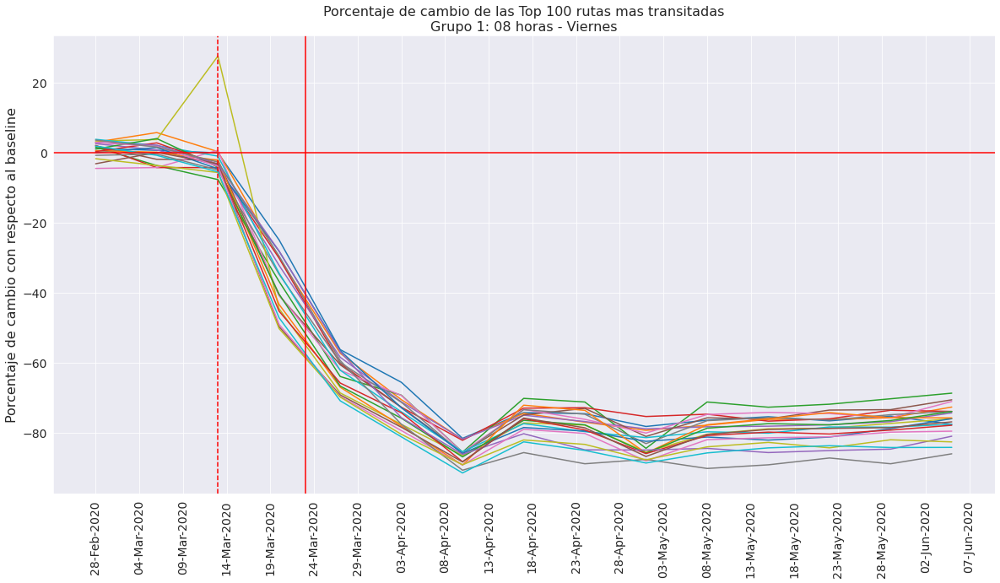

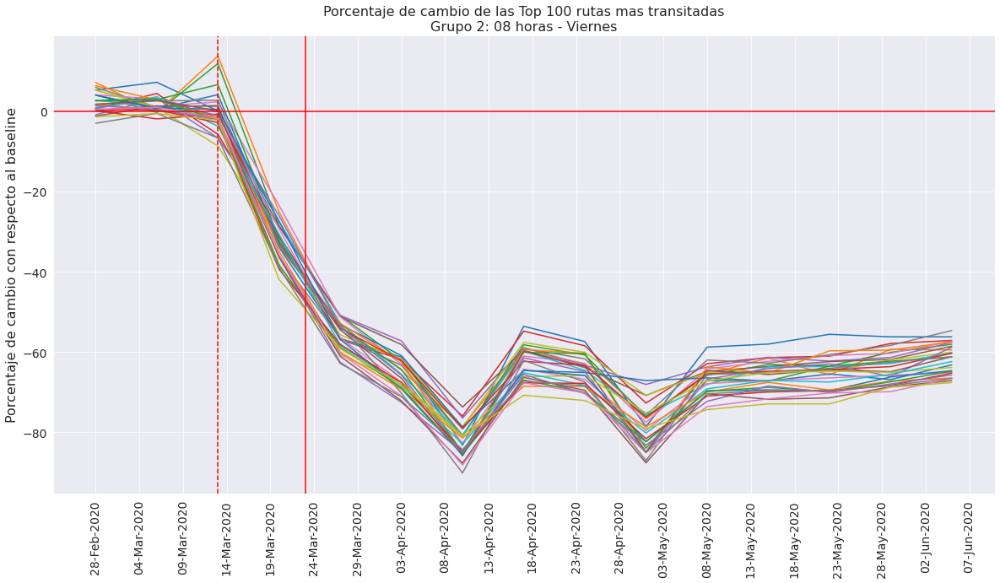

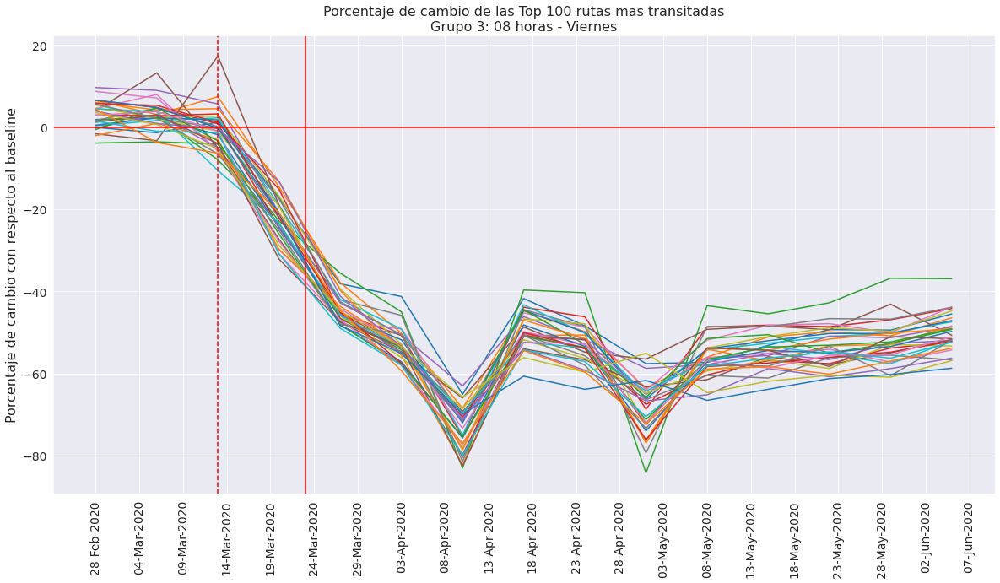

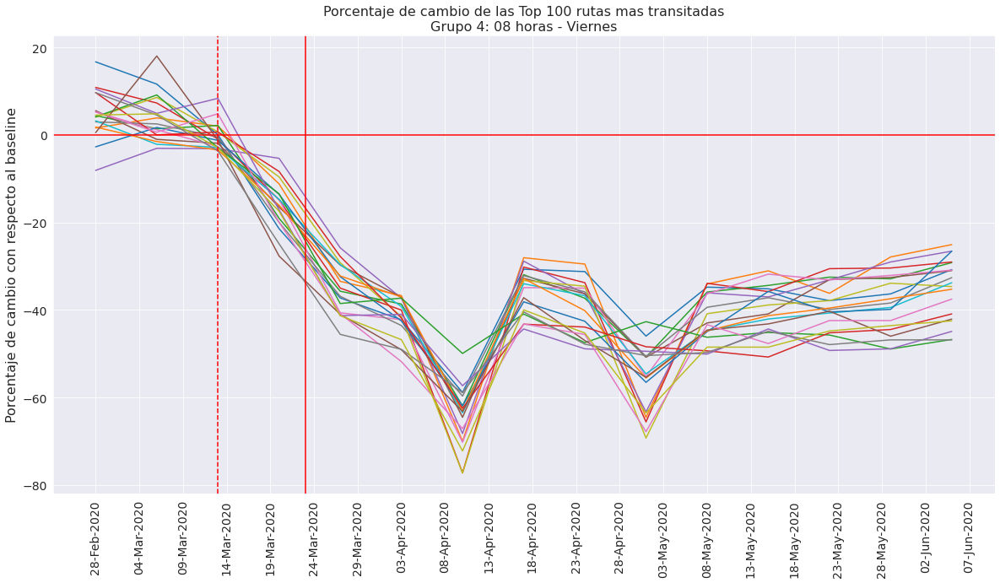

Grupo 1:  (-69.123, -54.377] 	N:  20
Grupo 2:  (-54.377, -39.69] 	N:  25
Grupo 3:  (-39.69, -25.003] 	N:  40
Grupo 4:  (-25.003, -10.316] 	N:  15


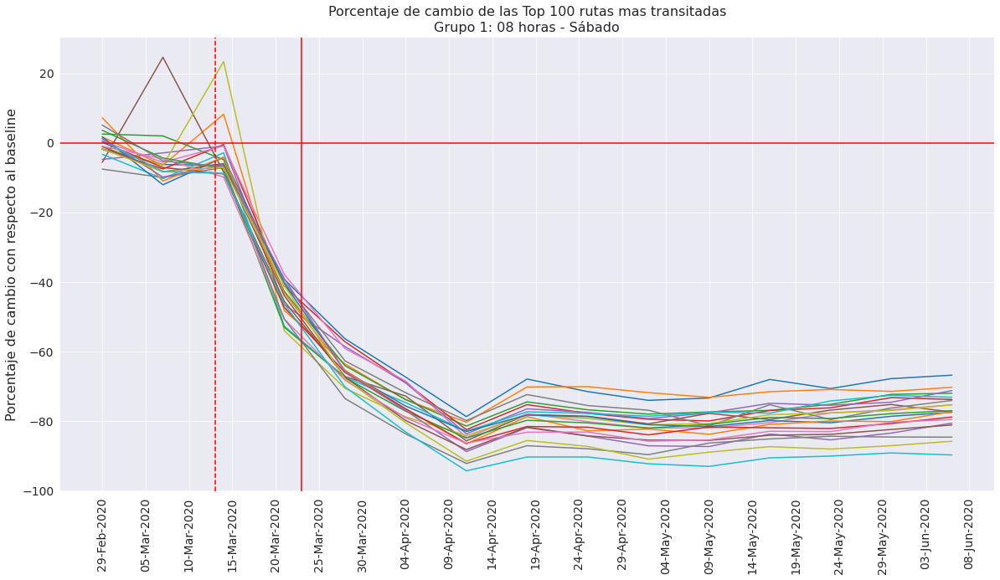

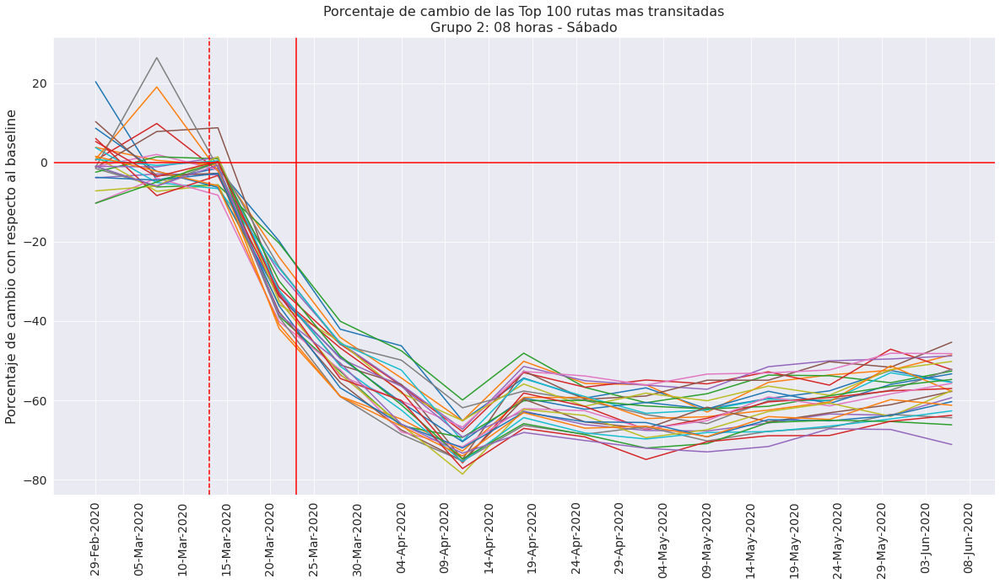

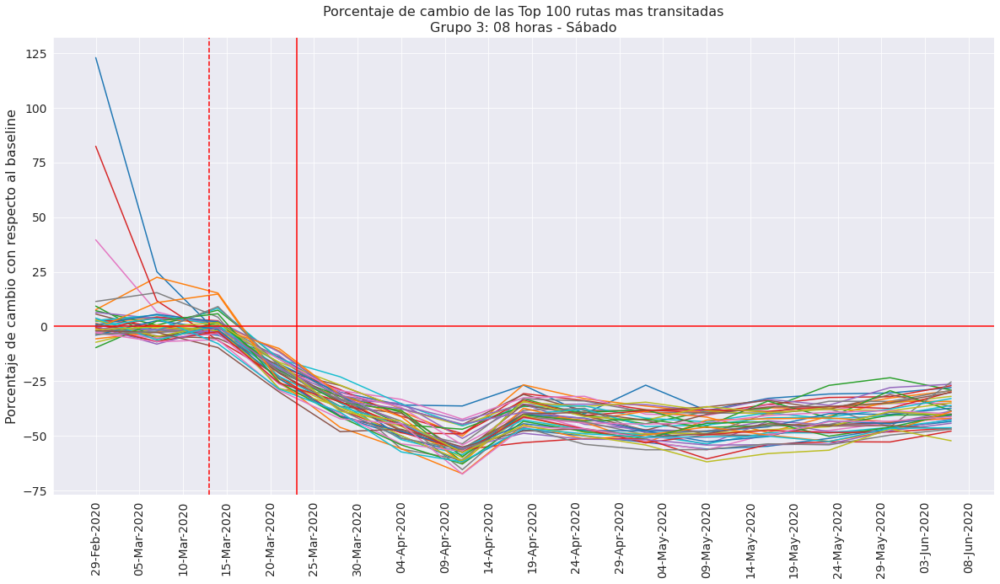

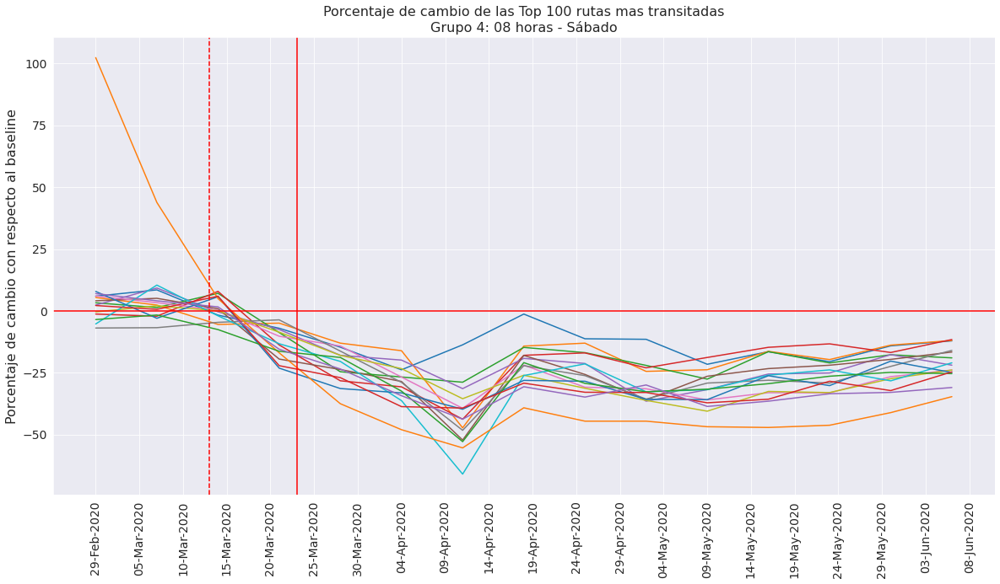

Grupo 1:  (-72.459, -50.606] 	N:  28
Grupo 2:  (-50.606, -28.841] 	N:  56
Grupo 3:  (-28.841, -7.075] 	N:  15
Grupo 4:  (-7.075, 14.69] 	N:  1


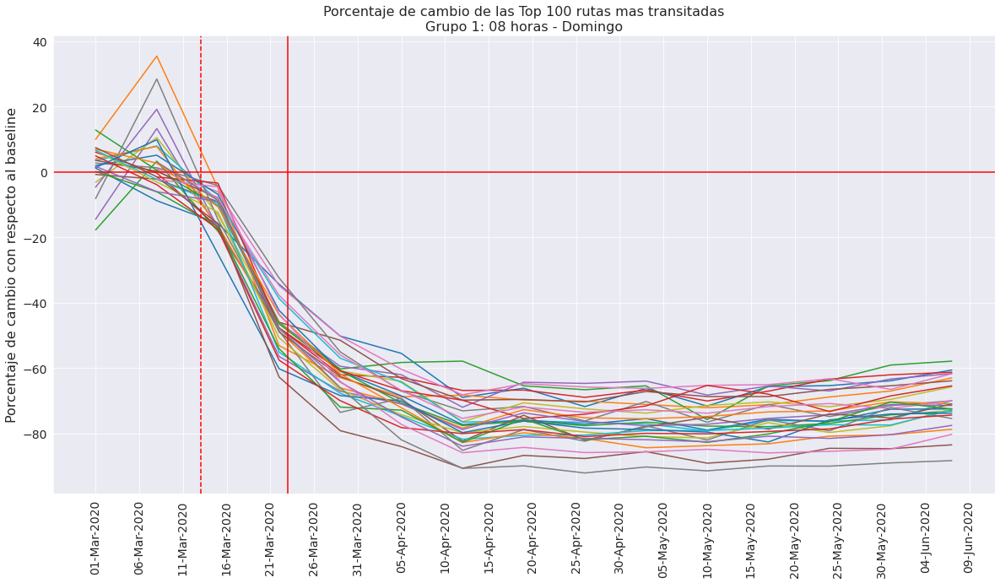

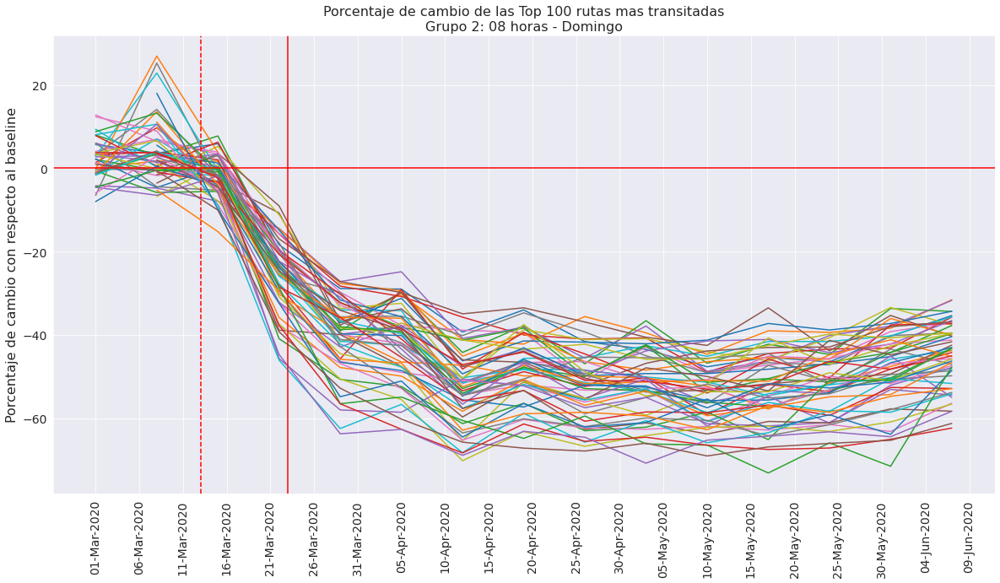

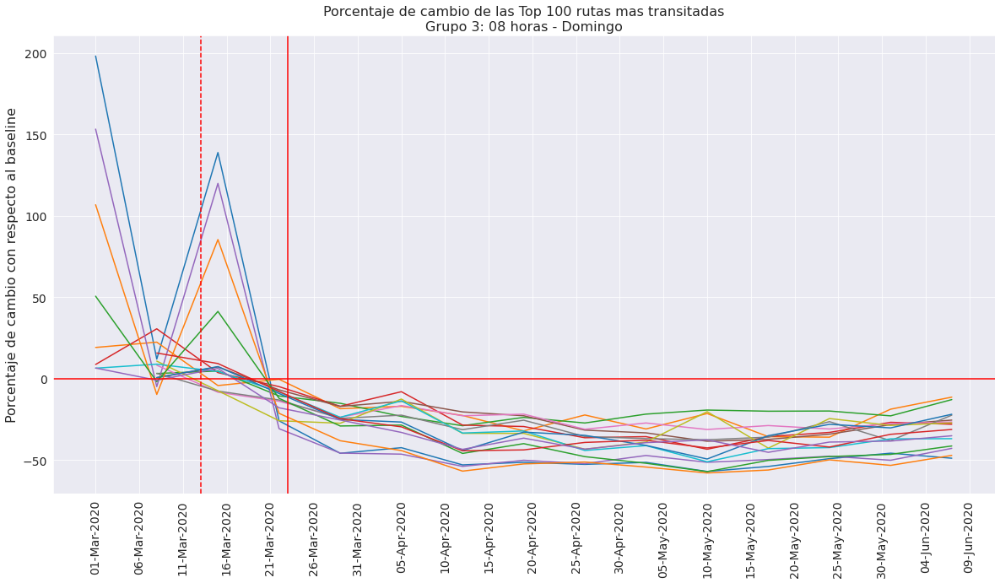

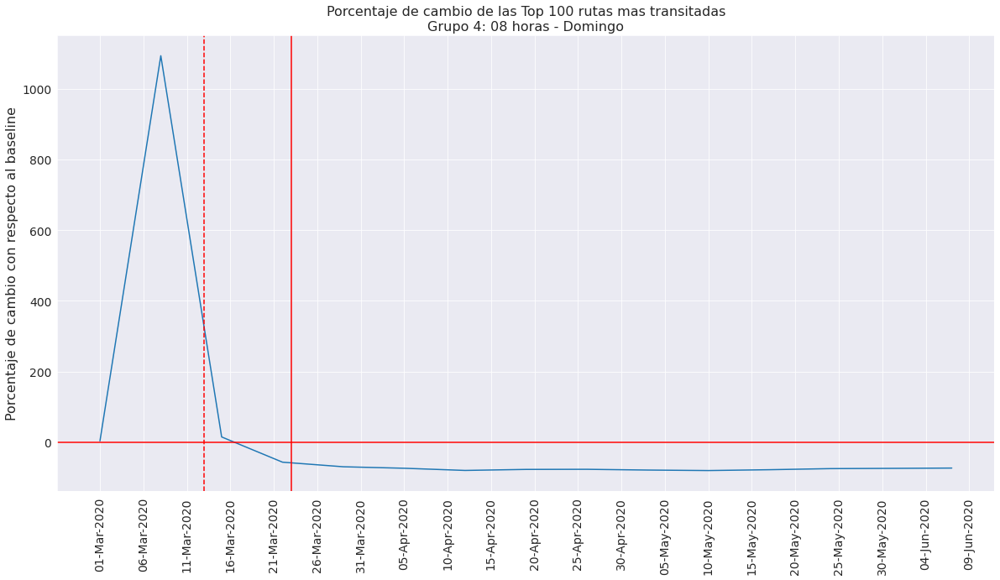

In [78]:
# Como se comportan las 100 rutas mas transitads por dia de la semana
top100_8hr_dia=[]

for i,dia in enumerate(lista_dias):
    df_aux = ruta_8hr_dias[i].loc[top100_inter_8hr_panel.index]
    
    # Porcentaje de cambio en el periodo de las 100 rutas mas transitadas por dia
    avg_top100 = df_aux.mean(axis=1, skipna=True).sort_values(ascending=False)
    #avg_top100_inter_00hr
    
    grupo1, grupo2, grupo3, grupo4, group_cat = asignar_rutas_en_grupos(df_aux, avg_top100)

    print('Grupo 1: ', group_cat[0], '\tN: ', grupo1.shape[0])
    print('Grupo 2: ', group_cat[1], '\tN: ', grupo2.shape[0])
    print('Grupo 3: ', group_cat[2], '\tN: ', grupo3.shape[0])
    print('Grupo 4: ', group_cat[3], '\tN: ', grupo4.shape[0])

    rutas = grupo1.index
    dias = grupo1.columns.get_level_values(1)
    grafica_cambio_en_en_tiempo_grupos_dia_semana(grupo1, rutas, dias, "Grupo 1: 08 horas - {}".format(dia), 0)
    
    rutas = grupo2.index
    dias = grupo2.columns.get_level_values(1)
    grafica_cambio_en_en_tiempo_grupos_dia_semana(grupo2, rutas, dias, "Grupo 2: 08 horas - {}".format(dia), 0)
    
    rutas = grupo3.index
    dias = grupo3.columns.get_level_values(1)
    grafica_cambio_en_en_tiempo_grupos_dia_semana(grupo3, rutas, dias, "Grupo 3: 08 horas - {}".format(dia), 0)
    
    rutas = grupo4.index
    dias = grupo4.columns.get_level_values(1)
    grafica_cambio_en_en_tiempo_grupos_dia_semana(grupo4, rutas, dias, "Grupo 4: 08 horas - {}".format(dia), 0)
    
    top100_8hr_dia.append(df_aux)


Grupo 1:  (-0.0929, 23.214] 	N:  163
Grupo 2:  (23.214, 46.429] 	N:  21
Grupo 3:  (46.429, 69.643] 	N:  8
Grupo 4:  (69.643, 92.857] 	N:  39


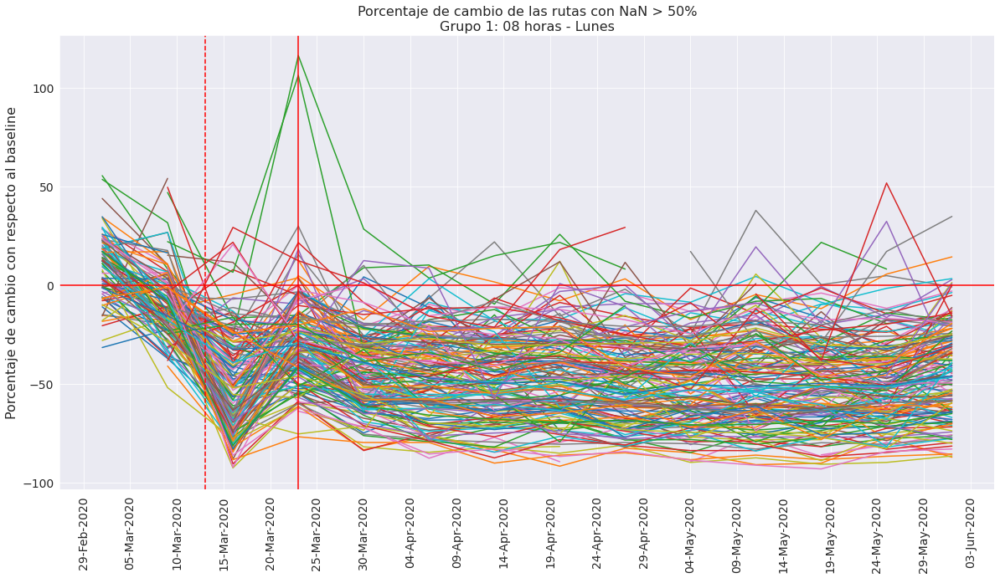

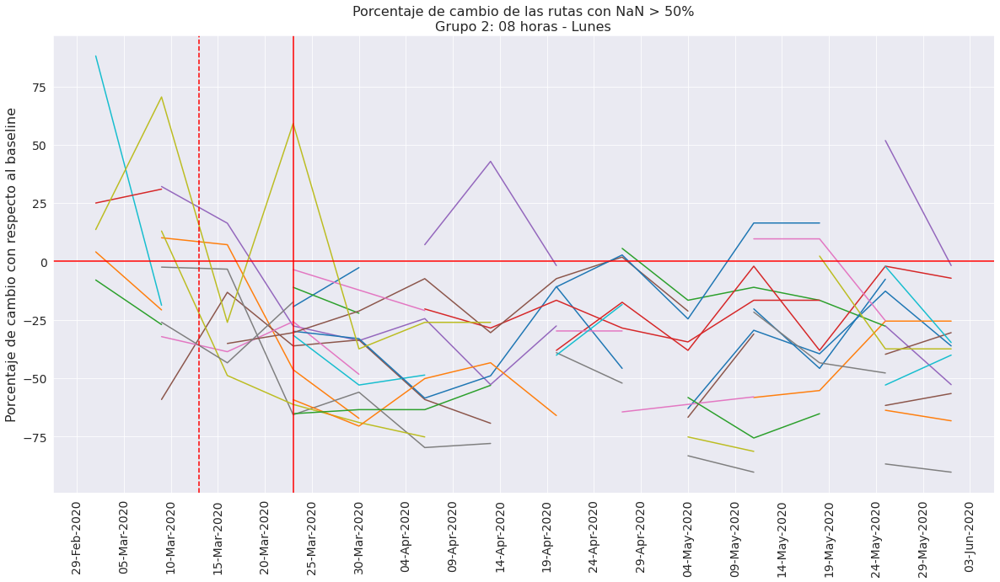

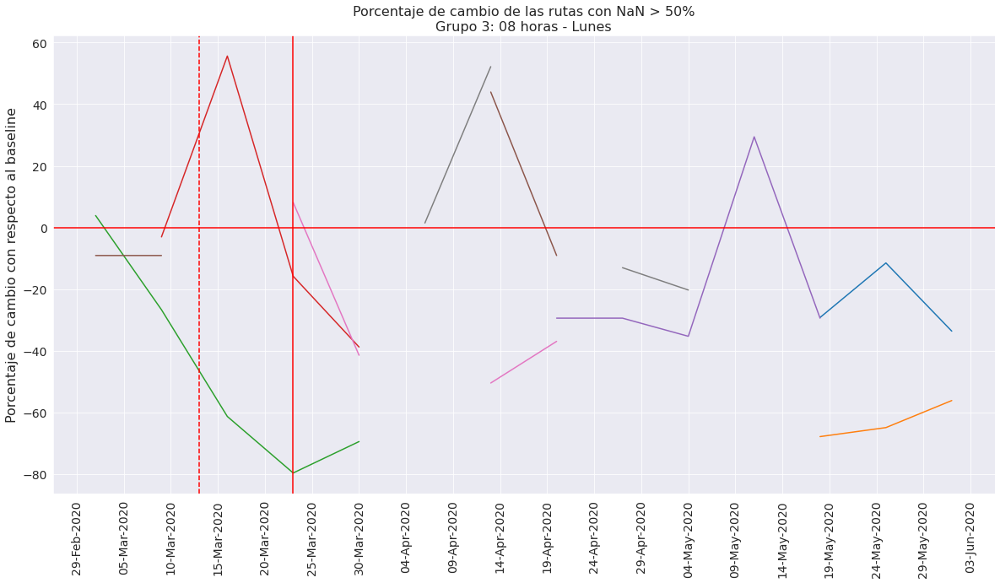

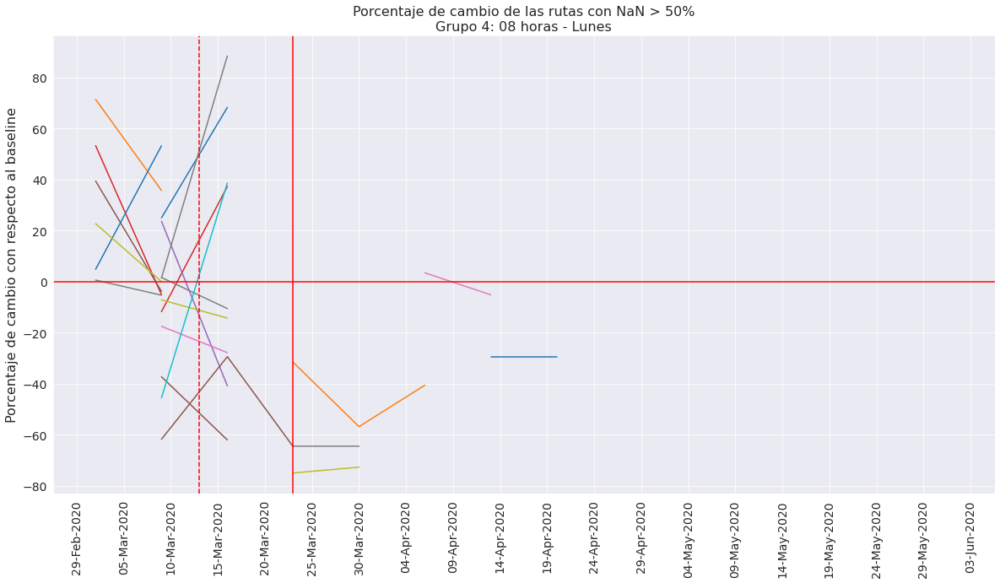

Grupo 1:  (-0.0929, 23.214] 	N:  140
Grupo 2:  (23.214, 46.429] 	N:  9
Grupo 3:  (46.429, 69.643] 	N:  14
Grupo 4:  (69.643, 92.857] 	N:  21


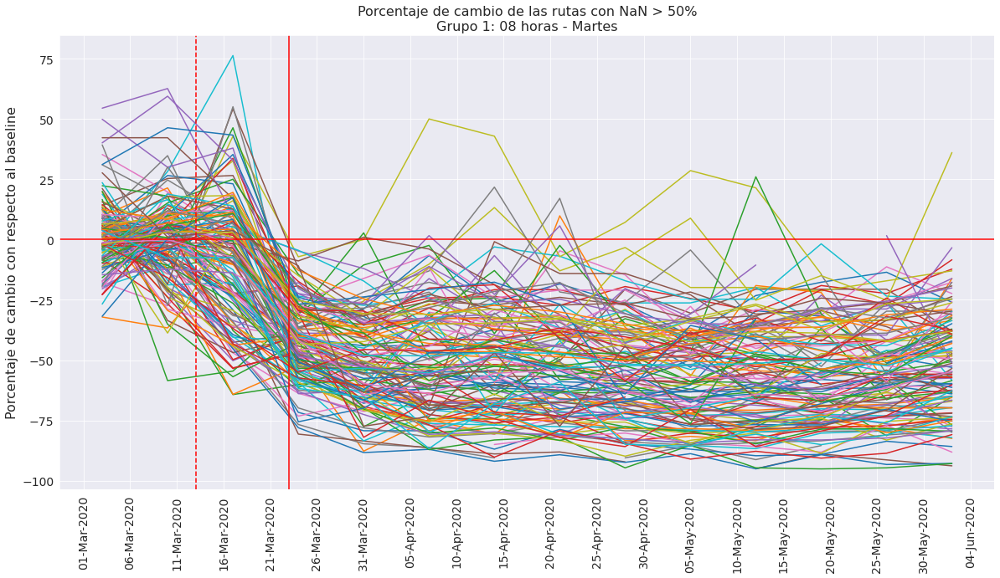

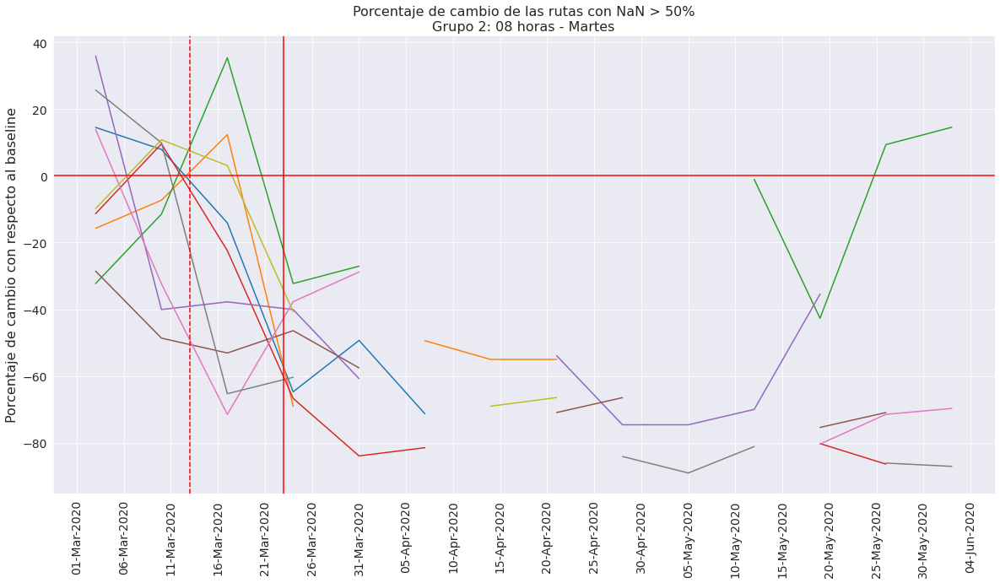

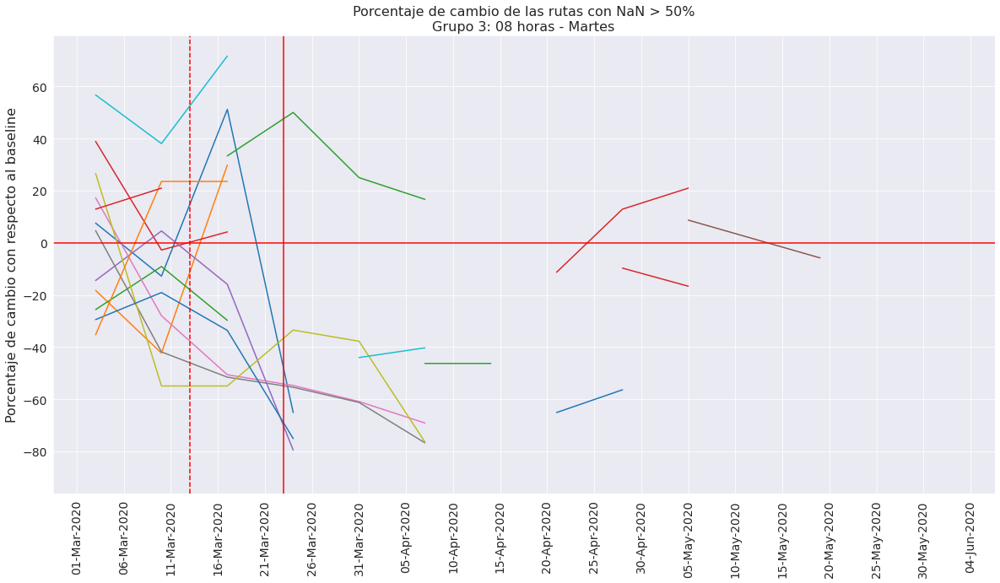

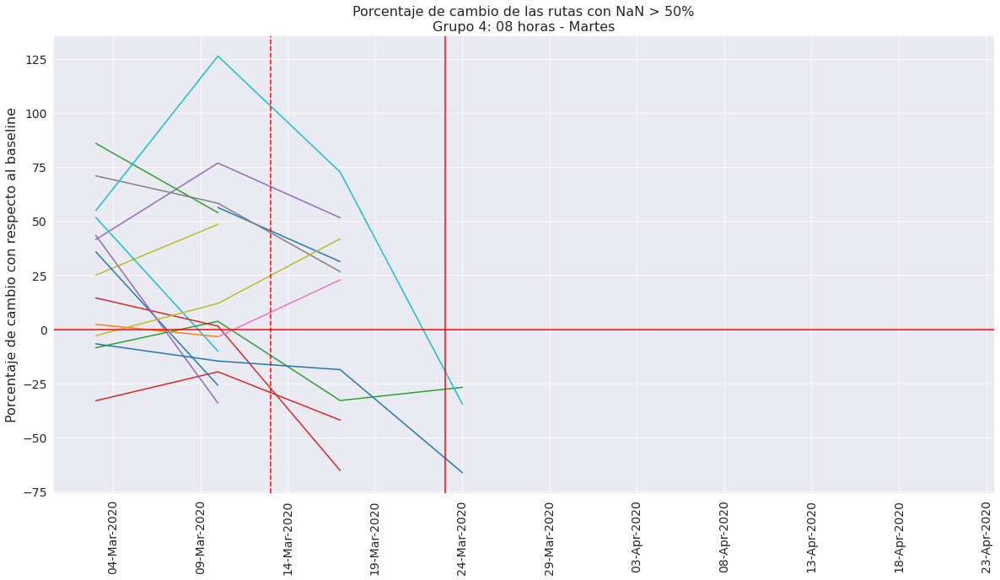

Grupo 1:  (-0.0929, 23.214] 	N:  153
Grupo 2:  (23.214, 46.429] 	N:  10
Grupo 3:  (46.429, 69.643] 	N:  14
Grupo 4:  (69.643, 92.857] 	N:  28


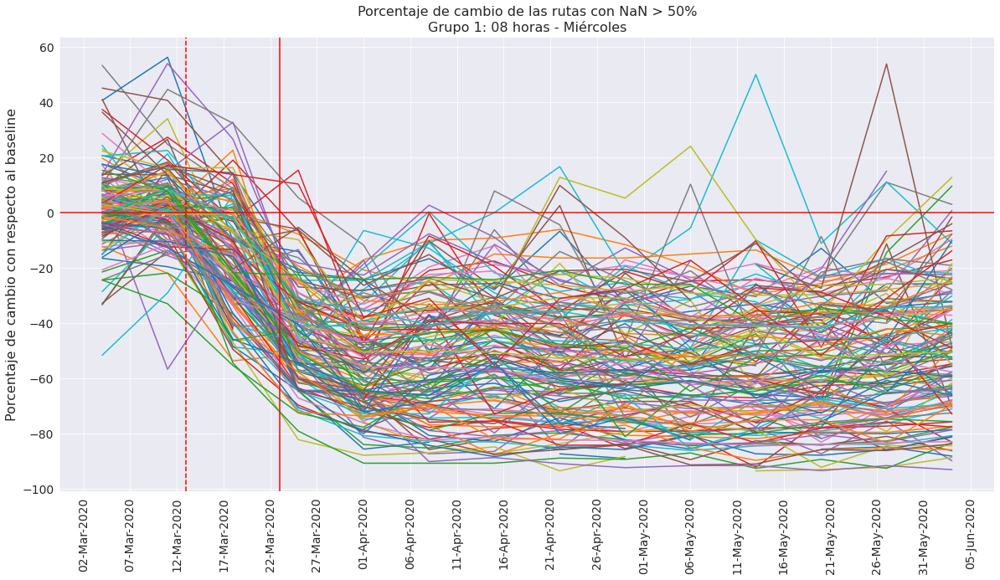

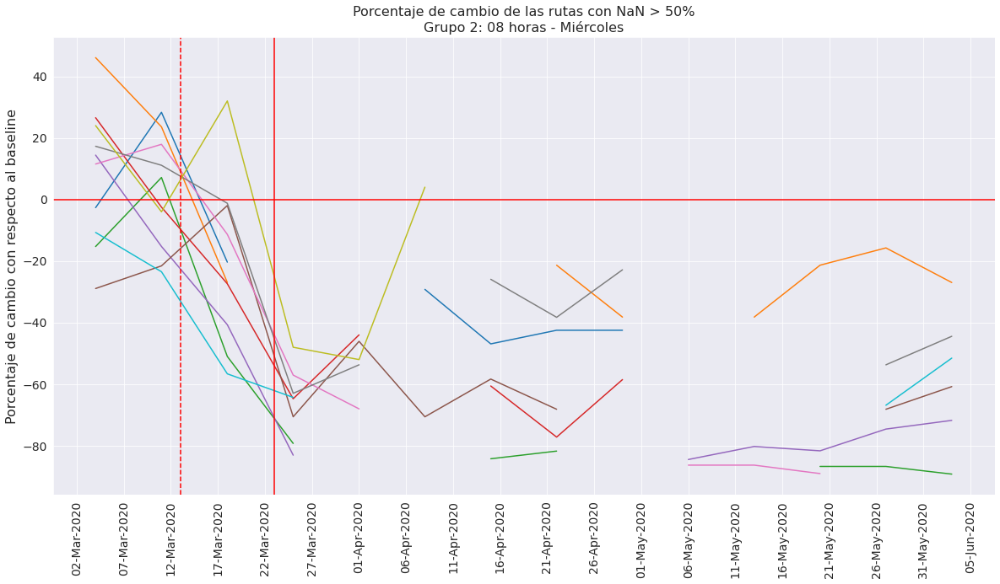

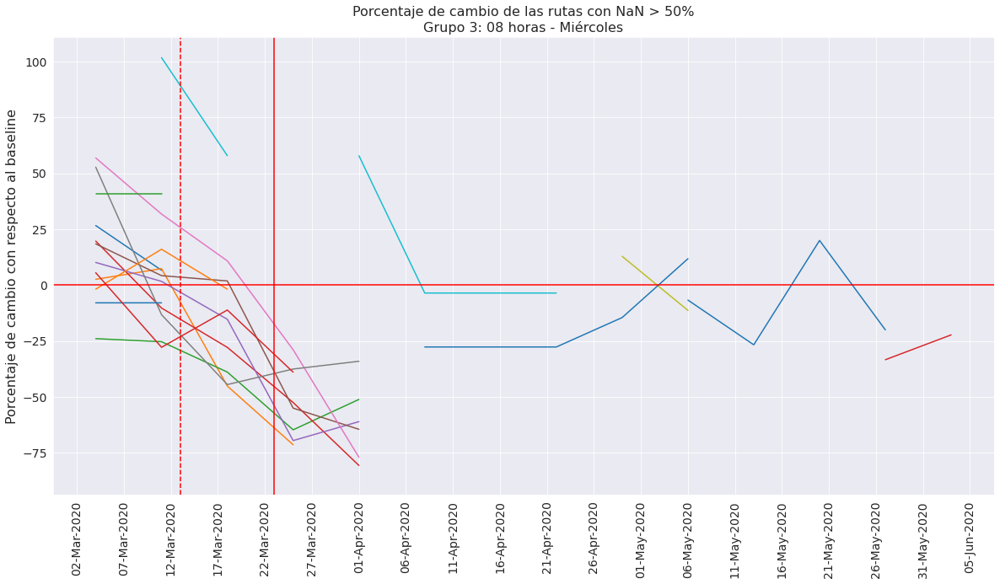

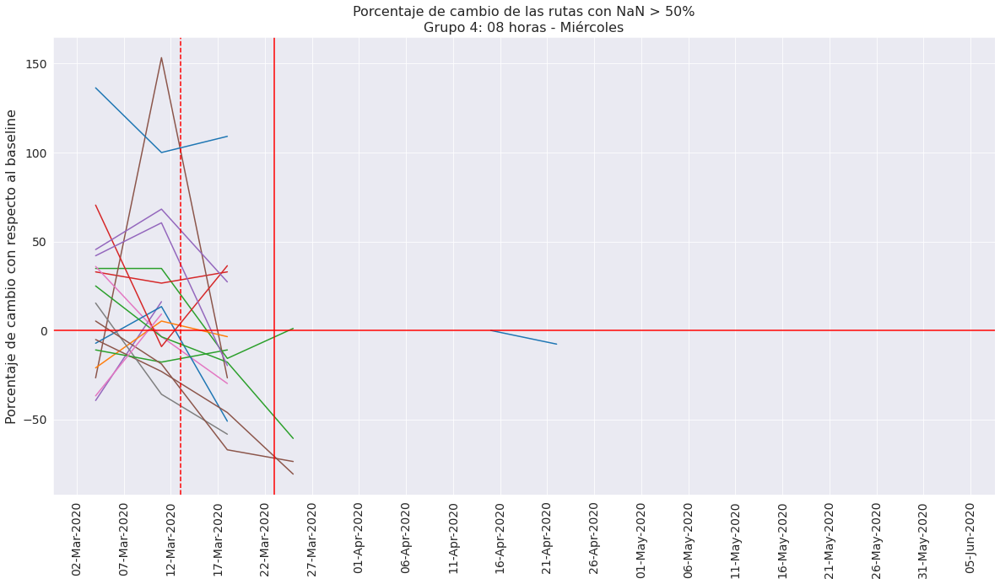

Grupo 1:  (-0.0933, 23.333] 	N:  153
Grupo 2:  (23.333, 46.667] 	N:  23
Grupo 3:  (46.667, 70.0] 	N:  17
Grupo 4:  (70.0, 93.333] 	N:  25


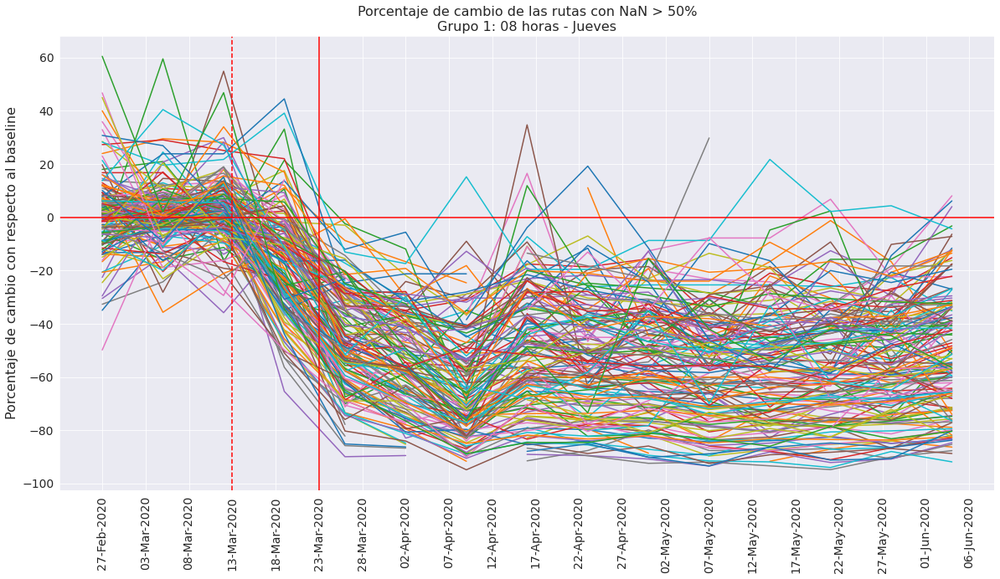

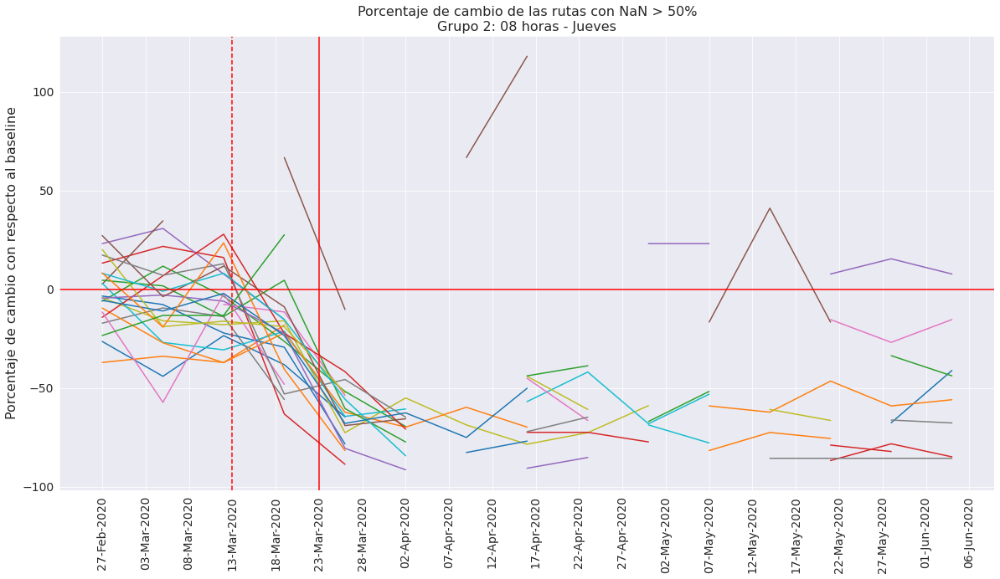

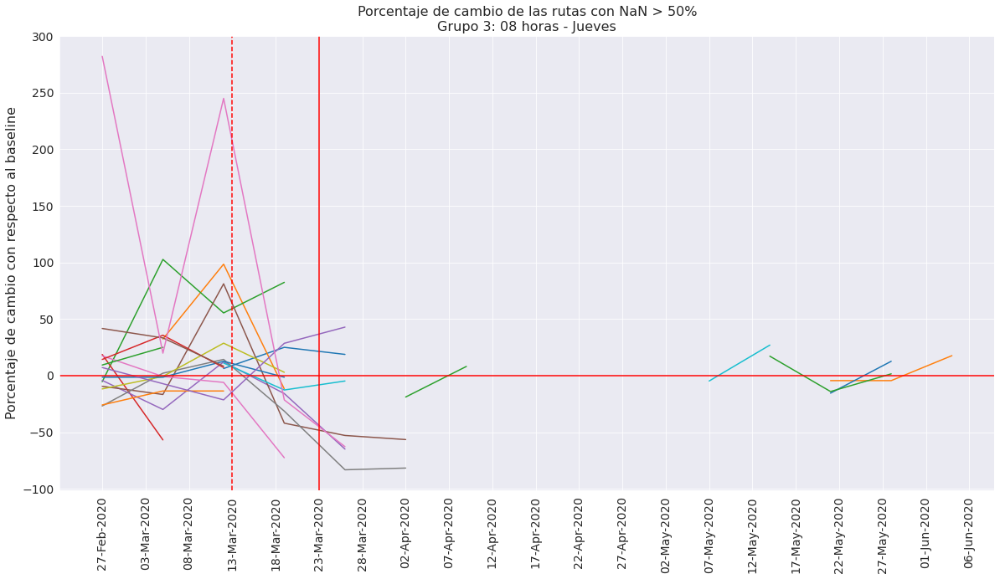

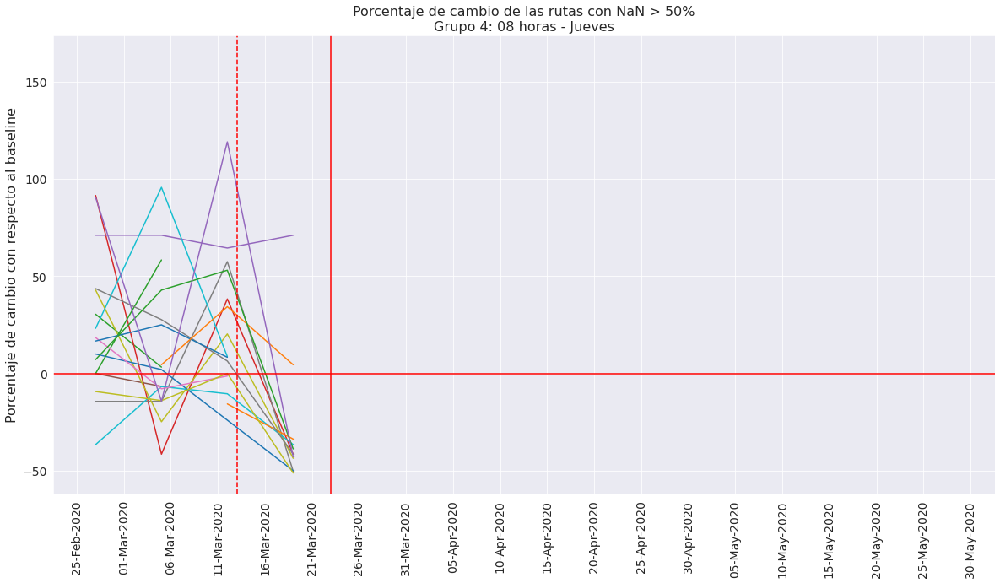

Grupo 1:  (-0.0933, 23.333] 	N:  160
Grupo 2:  (23.333, 46.667] 	N:  27
Grupo 3:  (46.667, 70.0] 	N:  13
Grupo 4:  (70.0, 93.333] 	N:  31


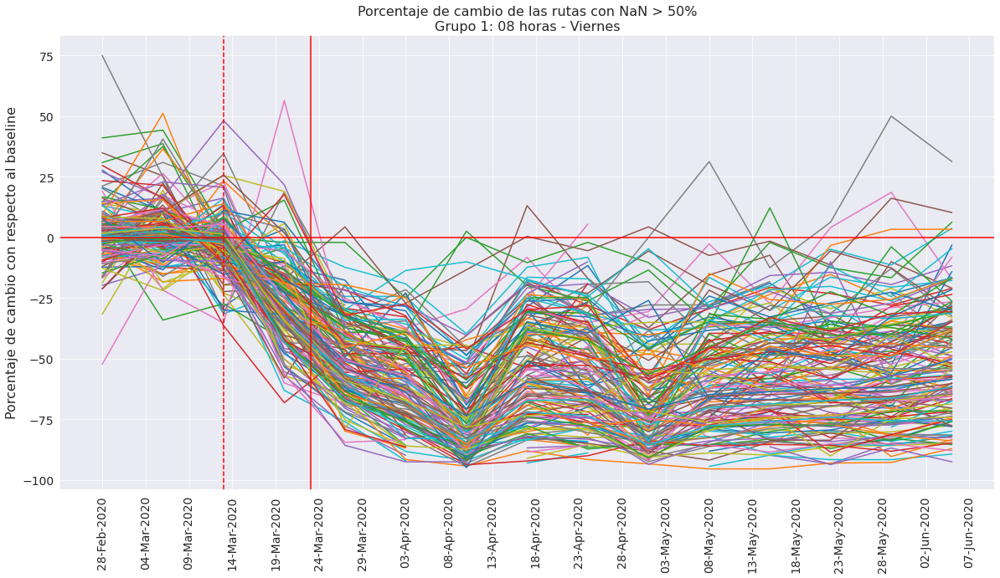

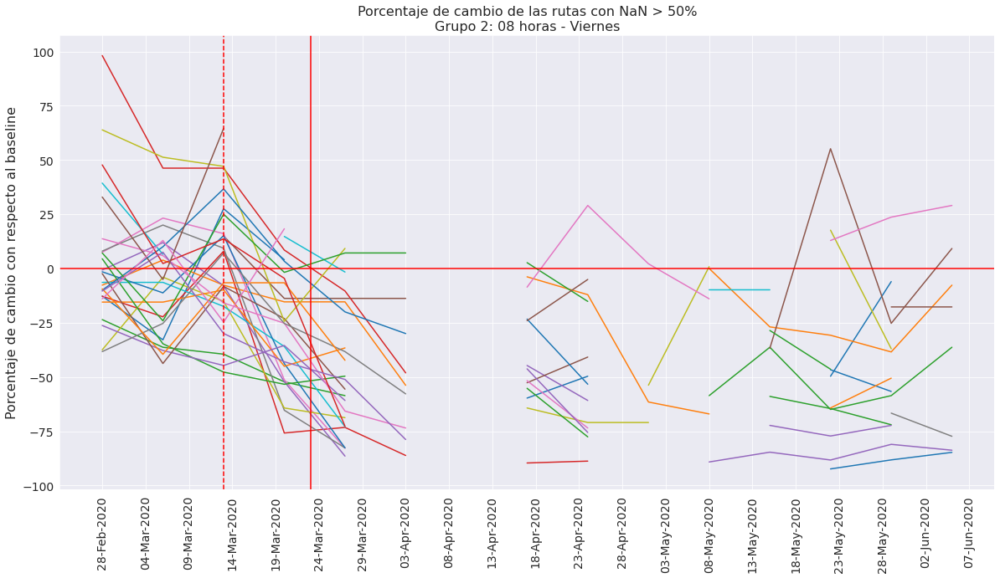

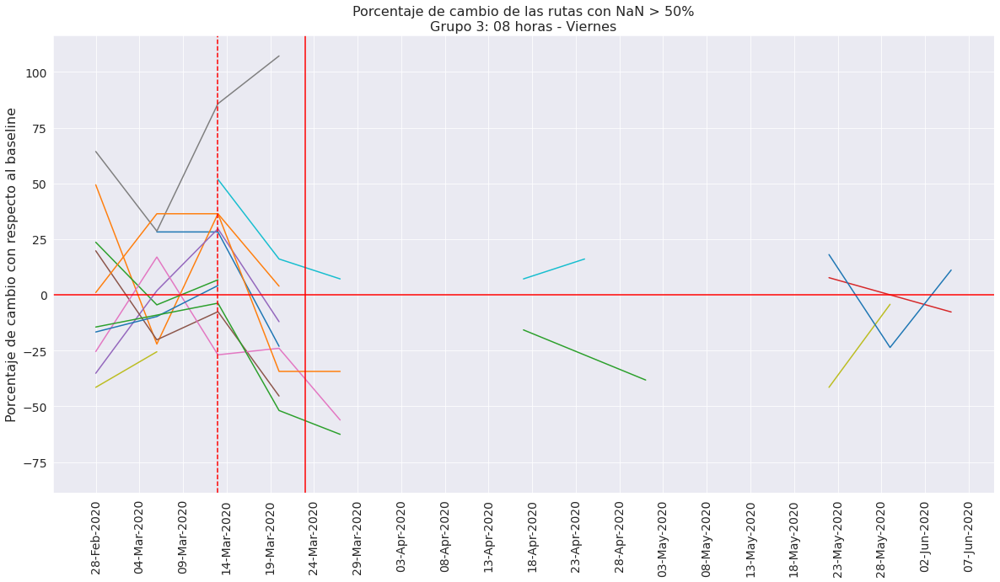

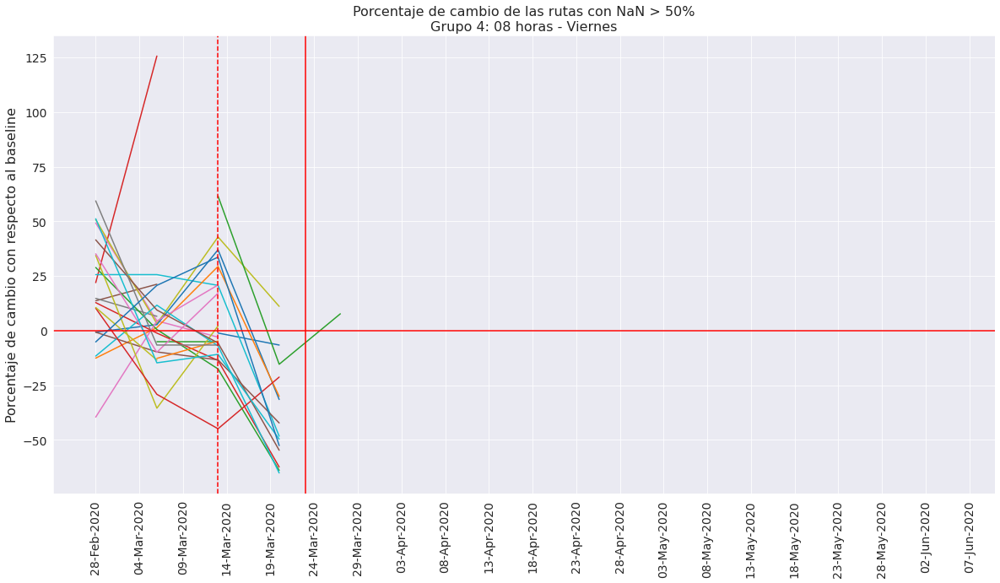

Grupo 1:  (-0.0933, 23.333] 	N:  137
Grupo 2:  (23.333, 46.667] 	N:  17
Grupo 3:  (46.667, 70.0] 	N:  22
Grupo 4:  (70.0, 93.333] 	N:  28


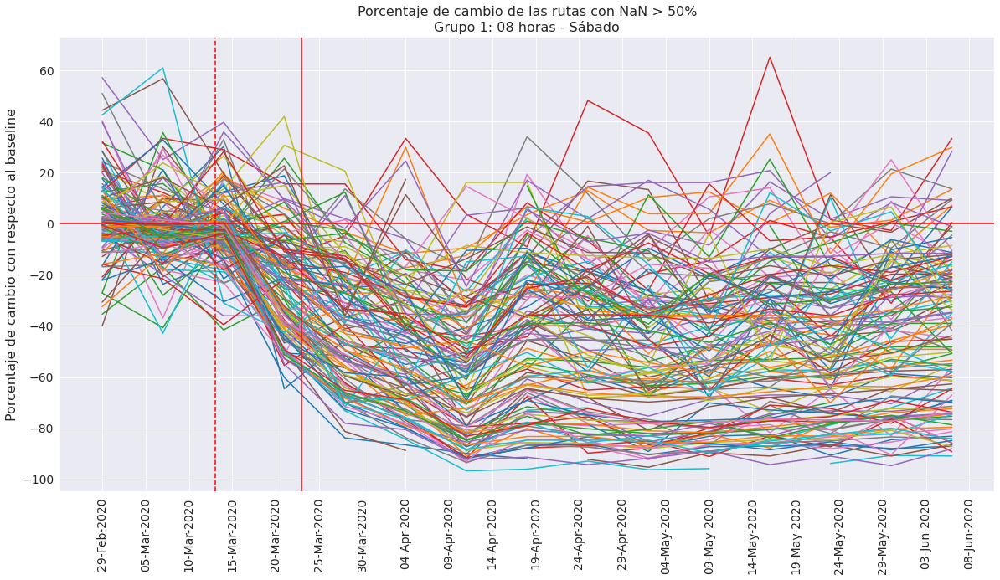

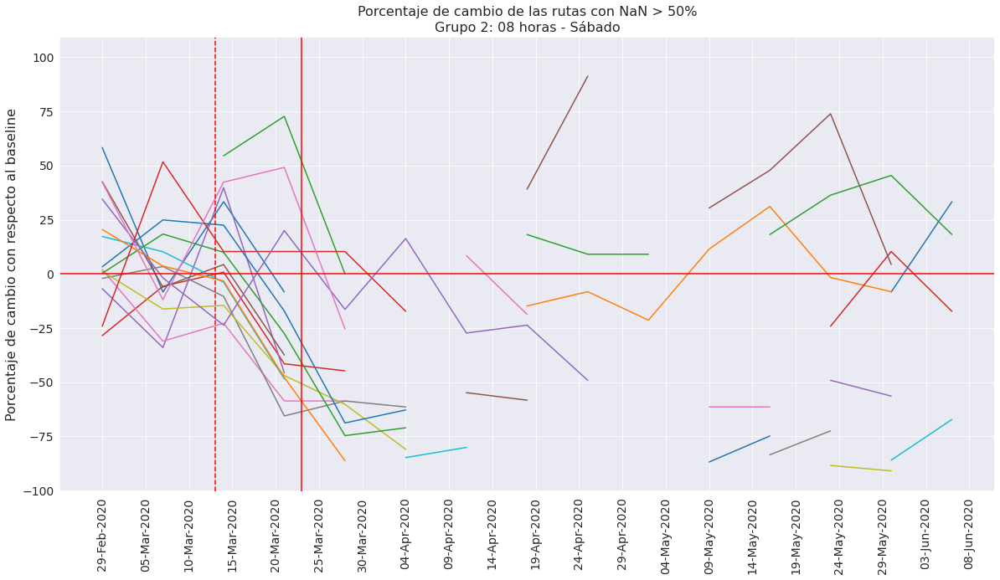

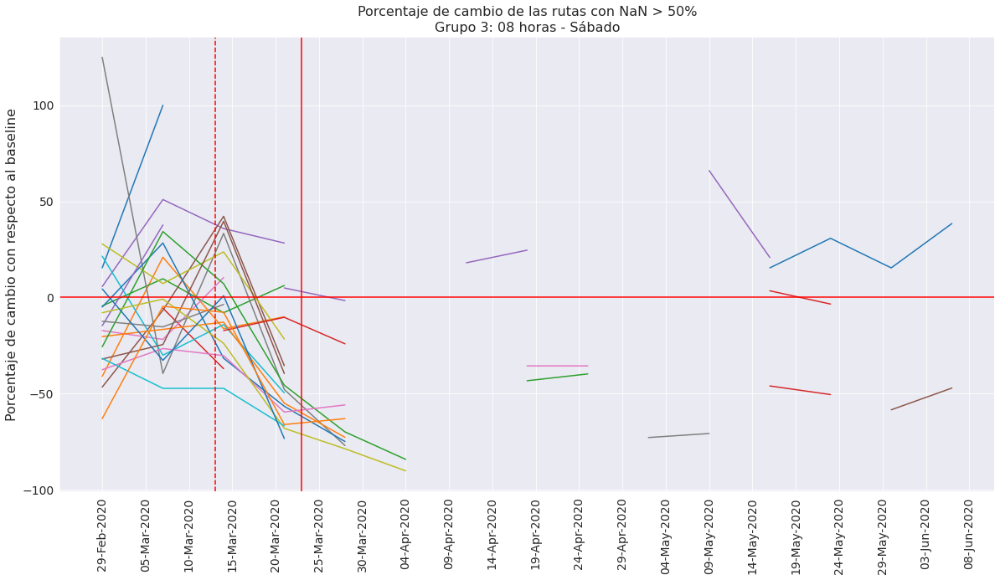

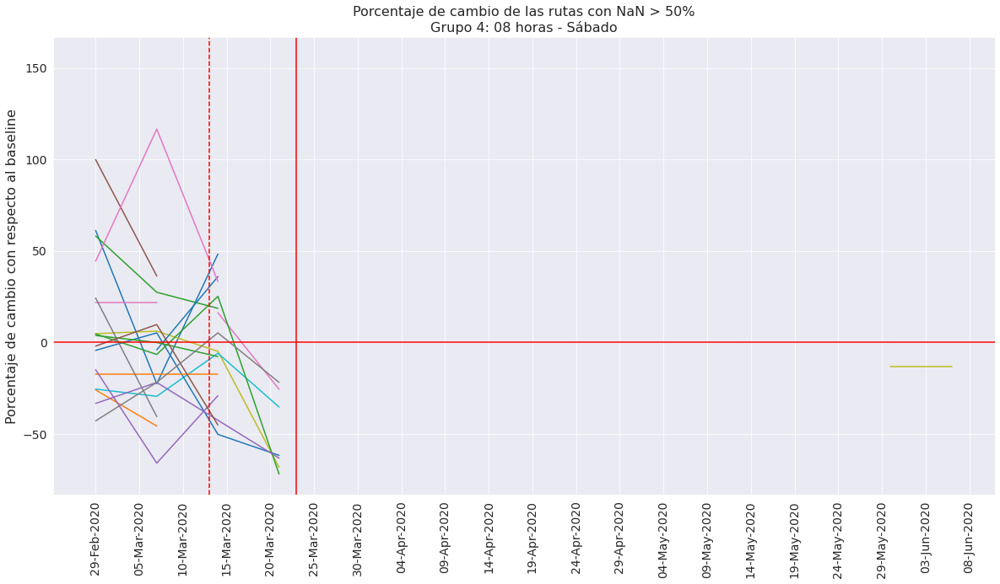

Grupo 1:  (-0.0933, 23.333] 	N:  158
Grupo 2:  (23.333, 46.667] 	N:  24
Grupo 3:  (46.667, 70.0] 	N:  27
Grupo 4:  (70.0, 93.333] 	N:  76


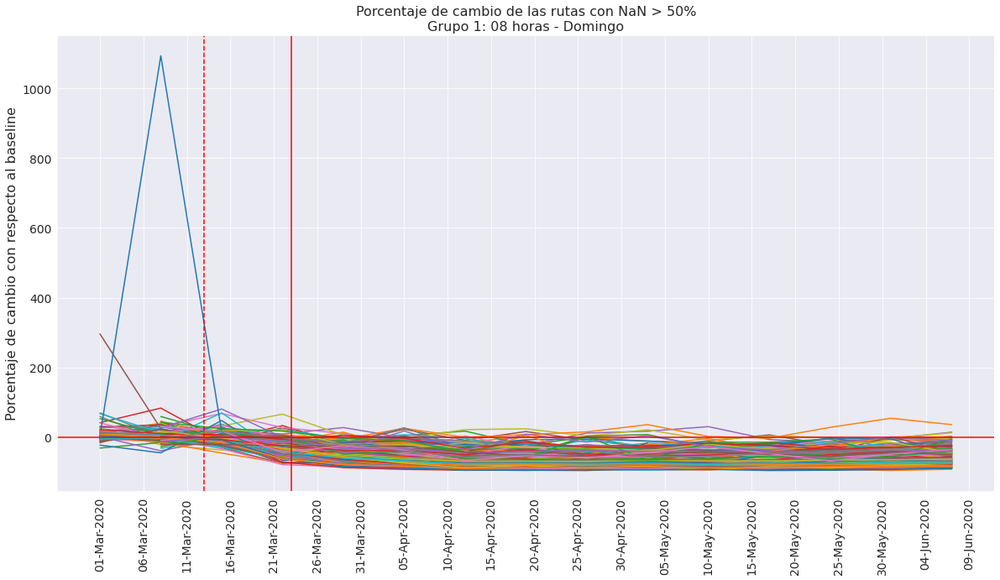

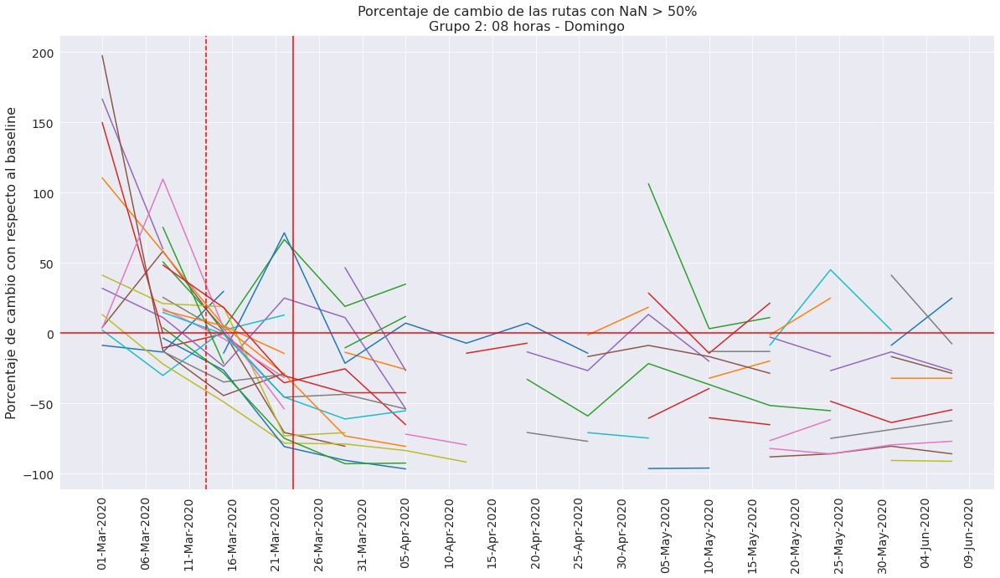

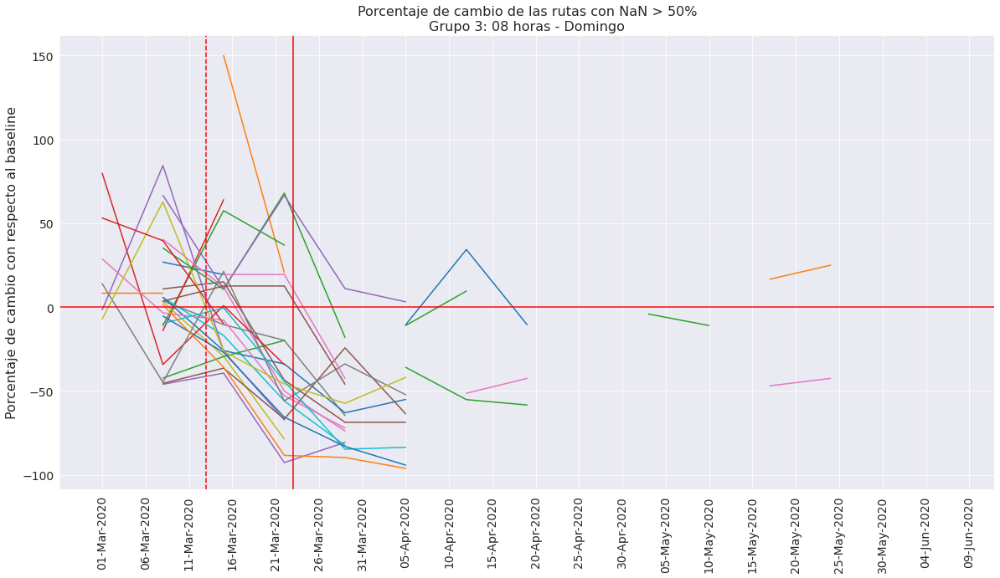

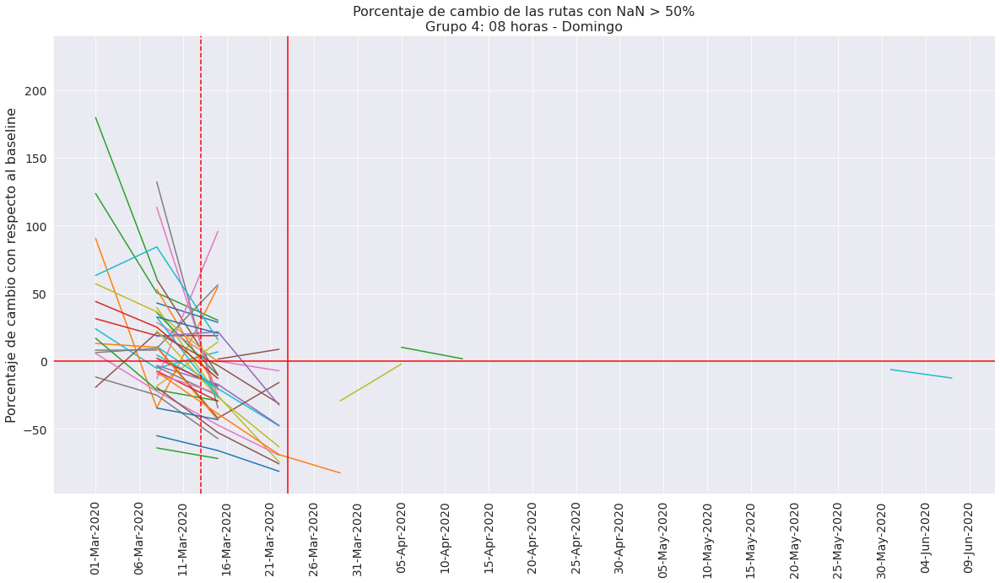

In [79]:
# Como se comportan las 100 rutas mas transitads por dia de la semana
nan_8hr_dia=[]

for i,dia in enumerate(lista_dias):
    nan = ruta_8hr_dias[i].isnull().mean(axis=1).sort_values(ascending=False)*100
    nan_index = ruta_8hr_dias[i][nan.values>50].index

    df_aux = ruta_8hr_dias[i].loc[nan_index]
    
    grupo1, grupo2, grupo3, grupo4, group_cat = asignar_rutas_en_grupos(df_aux, nan[nan_index])

    print('Grupo 1: ', group_cat[0], '\tN: ', grupo1.shape[0])
    print('Grupo 2: ', group_cat[1], '\tN: ', grupo2.shape[0])
    print('Grupo 3: ', group_cat[2], '\tN: ', grupo3.shape[0])
    print('Grupo 4: ', group_cat[3], '\tN: ', grupo4.shape[0])

    rutas = grupo1.index
    dias = grupo1.columns.get_level_values(1)
    grafica_cambio_en_en_tiempo_grupos_dia_semana(grupo1, rutas, dias, "Grupo 1: 08 horas - {}".format(dia), 1)
    
    rutas = grupo2.index
    dias = grupo2.columns.get_level_values(1)
    grafica_cambio_en_en_tiempo_grupos_dia_semana(grupo2, rutas, dias, "Grupo 2: 08 horas - {}".format(dia), 1)
    
    rutas = grupo3.index
    dias = grupo3.columns.get_level_values(1)
    grafica_cambio_en_en_tiempo_grupos_dia_semana(grupo3, rutas, dias, "Grupo 3: 08 horas - {}".format(dia), 1)
    
    rutas = grupo4.index
    dias = grupo4.columns.get_level_values(1)
    grafica_cambio_en_en_tiempo_grupos_dia_semana(grupo4, rutas, dias, "Grupo 4: 08 horas - {}".format(dia), 1)
    
    top100_8hr_dia.append(df_aux)

In [80]:
nan[nan.values>50].index

Index(['Milpa Alta - Chalco', 'Venustiano Carranza - Atizapán de Zaragoza',
       'Cocotitlán - Iztapalapa', 'Cocotitlán - Tlalpan',
       'Cocotitlán - Xochimilco', 'Cocotitlán - Álvaro Obregón',
       'Coyoacán - Atizapán de Zaragoza', 'Azcapotzalco - Tultepec',
       'Coyoacán - La Paz', 'Iztacalco - Tultitlán',
       ...
       'Cuautitlán - Nextlalpan', 'Cuautitlán - Atizapán de Zaragoza',
       'Cuautitlán Izcalli - Iztapalapa', 'Cuauhtémoc - Chalco',
       'Otumba - San Martín de las Pirámides',
       'Miguel Hidalgo - Coacalco de Berriozábal', 'Cuautitlán - Azcapotzalco',
       'Atenco - Gustavo A. Madero', 'Acolman - Texcoco',
       'Cuauhtémoc - Cuautitlán Izcalli'],
      dtype='object', name='ruta', length=285)

# DENUE

Datos para 2020

https://www.inegi.org.mx/app/descarga/?ti=6


In [83]:
# Cargar datos
cwd = Path(os.getcwd())
file = os.path.join(cwd,'data','DENUE','denue_data.csv')

data_denue = pd.read_csv(file, sep=',', low_memory=False)
#data_denue['codigo_act'] = data_denue['codigo_act'].astype(str)

In [212]:
# Diccionario de sectores
act_eco = pd.read_csv(os.path.join(cwd,'data','DENUE','dict_sectores2.csv'), sep=',', low_memory=False)
actividad = dict(zip(act_eco['Código'], act_eco['Título']))
sector = dict(zip(act_eco['Código'], act_eco['Nombre_corto']))
#sector

In [213]:
# agrego etiqueta de actividad economica
data_denue['actividad_economica'] = data_denue['codigo_act'].map(actividad, na_action='ignore')

# agrego etiqueta de sector economico
data_denue['sector_economico'] = data_denue['codigo_act'].where(data_denue['codigo_act'].isnull(),data_denue['codigo_act'].astype(str).str.slice(0,2)).astype(int).map(sector, na_action='ignore')

In [214]:
#data_denue[['codigo_act', 'actividad_economica', 'sector_economico' ]]

# Numero de establecimientos por Sector Economico en cada municipio
denue = data_denue[['municipio','sector_economico', 'nom_estab', 'per_ocu']].groupby(['municipio', 'sector_economico',]).size().unstack()


In [215]:
# Filtramos los municipios que nos interesan
denue = denue[denue.index.isin(alc_mun)]

# El principal sector economico por Municipio
denue['main_sector'] = denue.idxmax(axis=1)

# Bandera para saber si el municipio pertenence a la CDMX o no
denue = denue.assign(cdmx=np.where(denue.index.isin(delegaciones), 'CDMX', 'Otro'))

denue

sector_economico,"Agricultura, cría y explotación de recursos naturales",Comercio al por mayor,Comercio al por menor,Construcción,Corporativos,"Energía eléctrica, agua y gas natural",Industrias manufactureras,Información en medios masivos,Minería,Otros servicios excepto actividades gubernamentales,...,Servicios de apoyo a los negocios y manejo de residuos,Servicios de esparcimiento culturales y deportivos,Servicios de salud y de asistencia social,Servicios educativos,Servicios financieros y de seguros,Servicios inmobiliarios y de alquiler,"Servicios profesionales, científicos y técnicos","Transportes, correos y almacenamiento",main_sector,cdmx
municipio,,,,,,,,,,,,,,,,,,,,,
Acolman,NaN,205.0,3465.0,9.0,NaN,11.0,854.0,20.0,3.0,1063.0,...,117.0,59.0,219.0,196.0,32.0,57.0,63.0,14.0,Comercio al por menor,Otro
Amecameca,NaN,93.0,1394.0,8.0,NaN,1.0,219.0,6.0,NaN,380.0,...,47.0,27.0,101.0,80.0,34.0,36.0,53.0,6.0,Comercio al por menor,Otro
Atenco,NaN,82.0,1382.0,2.0,NaN,5.0,364.0,9.0,NaN,376.0,...,53.0,31.0,88.0,62.0,4.0,24.0,19.0,4.0,Comercio al por menor,Otro
Atizapán de Zaragoza,NaN,534.0,8957.0,52.0,NaN,26.0,1570.0,27.0,NaN,3112.0,...,308.0,248.0,696.0,524.0,280.0,177.0,322.0,81.0,Comercio al por menor,Otro
Axapusco,NaN,24.0,478.0,NaN,NaN,1.0,110.0,6.0,NaN,115.0,...,18.0,12.0,28.0,39.0,NaN,13.0,10.0,NaN,Comercio al por menor,Otro
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Venustiano Carranza,2.0,967.0,16653.0,61.0,1.0,13.0,1705.0,55.0,NaN,3578.0,...,351.0,251.0,957.0,542.0,562.0,308.0,350.0,598.0,Comercio al por menor,CDMX
Xalatlaco,NaN,16.0,583.0,NaN,NaN,2.0,191.0,3.0,1.0,122.0,...,21.0,21.0,30.0,16.0,3.0,9.0,13.0,12.0,Comercio al por menor,Otro
Xochimilco,1.0,445.0,10964.0,34.0,1.0,48.0,1588.0,31.0,NaN,2802.0,...,327.0,238.0,872.0,493.0,191.0,192.0,291.0,45.0,Comercio al por menor,CDMX


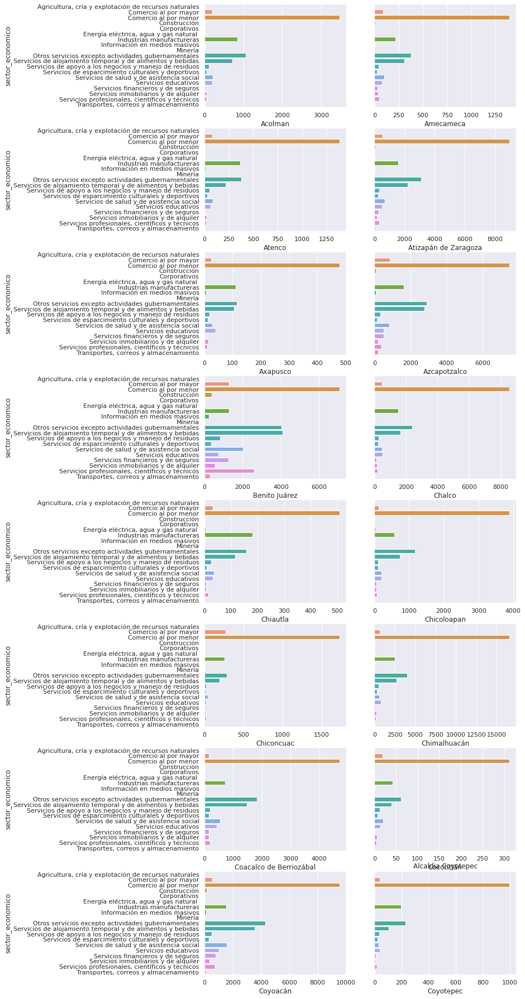

In [230]:
# Alcaldias
nr_rows = 8
nr_cols = 2

#cols_review = ['home_ownership', 'verification_status', 'loan_status']
#li_col_reviews = list(cols_review)

fig, axs = plt.subplots(nr_rows, nr_cols, figsize=(nr_cols*5,nr_rows*4))

for r in range(0,nr_rows):
    for c in range(0, nr_cols):  
        col = r*nr_cols+c
        
        sns.set(style="darkgrid")
        sns.barplot(denue.loc[denue.index[col]][0:19] , denue.columns[0:19],ax = axs[r][c])
        plt.title('Alcaldia {}'.format(denue.index[col]), fontsize=12)
        #plt.xlabel('', fontsize=12)
        plt.ylabel('')
        if c ==1:
            axs[r][c].get_yaxis().set_visible(False)
        
plt.show() 

## Ventana de tiempo: 08 horas

Filtramos por los municipios y alcaldias de las rutas que estan en la ventana de las 8 horas.


In [112]:
#denue_rutas_8hr_panel =

denue[(denue.index.isin(inter_rutas.loc[inter_rutas['hr']==8]['starting_region_name'].unique())) | (denue.index.isin(inter_rutas.loc[inter_rutas['hr']==8]['ending_region_name'].unique()))]

#denue.loc[denue.index.isin(denue.index)]       ending_region_name

#denue_rutas_8hr_panel
#denue_rutas_8hr_panel

sector_economico,"Agricultura, cría y explotación de animales, aprovechamiento forestal, pesca y caza",Comercio al por mayor,Comercio al por menor,Construcción,Corporativos,"Generación, transmisión, distribución y comercialización de energía eléctrica, suministro de agua y de gas natural por ductos al consumidor final",Industrias manufactureras,Información en medios masivos,Minería,Otros servicios excepto actividades gubernamentales,Servicios de alojamiento temporal y de preparación de alimentos y bebidas,"Servicios de apoyo a los negocios y manejo de residuos, y servicios de remediación","Servicios de esparcimiento culturales y deportivos, y otros servicios recreativos",Servicios de salud y de asistencia social,Servicios educativos,Servicios financieros y de seguros,Servicios inmobiliarios y de alquiler de bienes muebles e intangibles,"Servicios profesionales, científicos y técnicos","Transportes, correos y almacenamiento"
municipio,,,,,,,,,,,,,,,,,,,
Acolman,NaN,205.0,3465.0,9.0,NaN,11.0,854.0,20.0,3.0,1063.0,714.0,117.0,59.0,219.0,196.0,32.0,57.0,63.0,14.0
Amecameca,NaN,93.0,1394.0,8.0,NaN,1.0,219.0,6.0,NaN,380.0,309.0,47.0,27.0,101.0,80.0,34.0,36.0,53.0,6.0
Atenco,NaN,82.0,1382.0,2.0,NaN,5.0,364.0,9.0,NaN,376.0,217.0,53.0,31.0,88.0,62.0,4.0,24.0,19.0,4.0
Atizapán de Zaragoza,NaN,534.0,8957.0,52.0,NaN,26.0,1570.0,27.0,NaN,3112.0,2231.0,308.0,248.0,696.0,524.0,280.0,177.0,322.0,81.0
Axapusco,NaN,24.0,478.0,NaN,NaN,1.0,110.0,6.0,NaN,115.0,104.0,18.0,12.0,28.0,39.0,NaN,13.0,10.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Valle de Chalco Solidaridad,1.0,416.0,9351.0,13.0,NaN,28.0,1712.0,31.0,NaN,2761.0,2122.0,325.0,291.0,523.0,480.0,93.0,187.0,197.0,39.0
Venustiano Carranza,2.0,967.0,16653.0,61.0,1.0,13.0,1705.0,55.0,NaN,3578.0,4255.0,351.0,251.0,957.0,542.0,562.0,308.0,350.0,598.0
Xochimilco,1.0,445.0,10964.0,34.0,1.0,48.0,1588.0,31.0,NaN,2802.0,2169.0,327.0,238.0,872.0,493.0,191.0,192.0,291.0,45.0


In [116]:
inter_rutas_8hr_panel.index.astype(str).str.split(' - ', 2)

Index([                            ['Acolman', 'Atenco'],
                             ['Acolman', 'Azcapotzalco'],
                                 ['Acolman', 'Chiautla'],
                               ['Acolman', 'Cuauhtémoc'],
                      ['Acolman', 'Ecatepec de Morelos'],
                        ['Acolman', 'Gustavo A. Madero'],
                           ['Acolman', 'Miguel Hidalgo'],
              ['Acolman', 'San Martín de las Pirámides'],
                                  ['Acolman', 'Tecámac'],
                              ['Acolman', 'Teotihuacán'],
       ...
               ['Álvaro Obregón', 'Naucalpan de Juárez'],
                    ['Álvaro Obregón', 'Nezahualcóyotl'],
                           ['Álvaro Obregón', 'Tecámac'],
               ['Álvaro Obregón', 'Tlalnepantla de Baz'],
                           ['Álvaro Obregón', 'Tlalpan'],
                           ['Álvaro Obregón', 'Tláhuac'],
                         ['Álvaro Obregón', 'Tultitlán'],
   

In [ ]:
#
inter_rutas_desaparecidas_index